In [1]:
# Exact versions fastdup 2.39 expects
!pip install -q --force-reinstall \
  "numpy==1.26.4" \
  "pandas==2.1.4" \
  "pyarrow==14.0.1" \
  "polars==0.20.0" \
  "fastdup==2.39"

import IPython
IPython.Application.instance().kernel.do_shutdown(restart=True)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 3.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.6/57.6 kB 3.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 5.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 92.6 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.2/12.2 MB 108.9 MB/s eta 0:00:0000:010:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.0/38.0 MB 46.6 MB/s eta 0:00:00:00:010:01m
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 28.4/28.4 MB 25.7 MB/s eta 0:00:0000:01:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.1/93.1 MB 3.0 MB/s eta 0:00:0000:0100:02
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 54.4 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.2/20.2 MB 4.2 MB/s eta 0:00:0000:0100:01m
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 95.6/95.6 kB

{'status': 'ok', 'restart': True}

In [1]:
import numpy as np 
import pandas as pd

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        os.path.join(dirname, filename)

print('Walk complete')

Walk complete


In [2]:
import shutil
from sklearn.model_selection import train_test_split

# Data Analysis

In [3]:
import os
import json
import shutil
import random
import itertools
from pathlib import Path
from typing import List, Optional
from PIL import Image
from fastdup import fastdup
from collections import Counter
import cv2

In [4]:
TRAIN_DIR = "/kaggle/working/data/land_animals_split/train"
VAL_DIR = "/kaggle/working/data/land_animals_split/val"
TEST_DIR = "/kaggle/working/data/land_animals_split/test"

BASE = "/kaggle/working/data/land_animals_split"

# TRAIN_DIR = f"{BASE}/train"
# VAL_DIR   = f"{BASE}/val"
WORK_DIR  = "/kaggle/working"

Path(WORK_DIR).mkdir(parents=True, exist_ok=True)
REPORT_DIR = f"{WORK_DIR}/reports"
REVIEW_DIR = f"{WORK_DIR}/review"
Path(REPORT_DIR).mkdir(parents=True, exist_ok=True)

IMG_EXTS = {".jpg", ".jpeg", ".png", ".bmp", ".webp"}

In [5]:
def collect_image_sizes(root_dir, max_samples=5000):
    sizes = []
    exts = (".jpg", ".jpeg", ".png", ".bmp", ".webp")
    count = 0
    for root, _, files in os.walk(root_dir):
        for f in files:
            if not f.lower().endswith(exts):
                continue
            path = os.path.join(root, f)
            try:
                with Image.open(path) as img:
                    sizes.append(img.size)  # (width, height)
            except Exception as e:
                print("Error reading:", path, e)
            count += 1
            if max_samples and count >= max_samples:
                return sizes
    return sizes

# Collect sizes from a sample of train and val
train_sizes = collect_image_sizes(TRAIN_DIR, max_samples=None)  # None = all images
val_sizes   = collect_image_sizes(VAL_DIR, max_samples=None)

print(f"Train images checked: {len(train_sizes)}")
print(f"Val images checked: {len(val_sizes)}")

# Put into DataFrame for stats
df_train = pd.DataFrame(train_sizes, columns=["width","height"])
df_val   = pd.DataFrame(val_sizes, columns=["width","height"])

print("\nTrain image size summary:")
df_train.describe()

Train images checked: 3690
Val images checked: 810

Train image size summary:


,width,height
count,3690.000000,3690.000000
mean,795.866125,555.402168
std,730.825597,536.178469
min,145.000000,120.000000
25%,275.000000,183.000000
50%,432.000000,309.500000
75%,1200.000000,720.000000
max,4928.000000,4064.000000


In [6]:
print("\nVal image size summary:")
df_val.describe()


Val image size summary:


,width,height
count,810.000000,810.000000
mean,848.680247,587.695062
std,767.299804,554.866380
min,177.000000,122.000000
25%,275.000000,183.000000
50%,599.500000,400.000000
75%,1200.000000,773.250000
max,4896.000000,3264.000000


In [7]:
test_sizes   = collect_image_sizes(TEST_DIR, max_samples=None)
df_test   = pd.DataFrame(test_sizes, columns=["width","height"])
print("\nTest image size summary:")
df_test.describe()


Test image size summary:


,width,height
count,900.000000,900.000000
mean,824.678889,594.961111
std,741.089696,573.063694
min,176.000000,129.000000
25%,275.000000,183.000000
50%,515.000000,388.000000
75%,1200.000000,799.250000
max,4458.000000,3543.000000


In [8]:
# Most common sizes
print("\nMost common train sizes:")
print(Counter(train_sizes).most_common(10))


Most common train sizes:
[((275, 183), 326), ((300, 168), 249), ((259, 194), 145), ((225, 225), 120), ((299, 168), 73), ((310, 163), 45), ((1200, 800), 42), ((1200, 675), 40), ((1200, 900), 38), ((1200, 1200), 35)]


In [9]:
print("\nMost common val sizes:")
print(Counter(val_sizes).most_common(10))


Most common val sizes:
[((275, 183), 78), ((300, 168), 47), ((259, 194), 33), ((225, 225), 26), ((299, 168), 18), ((1200, 900), 11), ((318, 159), 8), ((1200, 675), 8), ((1280, 720), 8), ((1200, 630), 7)]


In [10]:
print("\nMost common test sizes:")
print(Counter(test_sizes).most_common(10))


Most common test sizes:
[((275, 183), 73), ((300, 168), 48), ((259, 194), 46), ((225, 225), 26), ((1200, 900), 13), ((299, 168), 12), ((1200, 1200), 12), ((1200, 800), 10), ((1280, 720), 9), ((1200, 675), 9)]


In [11]:
len(train_sizes)

3690

# FastDup Analysis

In [12]:
from fastdup import run as fastdup_run

In [13]:
import warnings

warnings.filterwarnings('ignore')

In [14]:
fd = fastdup.create(input_dir=TRAIN_DIR)
fd.run(overwrite=True)

fastdup By Visual Layer, Inc. 2024. All rights reserved.



fastdup By Visual Layer, Inc. 2024. All rights reserved.

A fastdup dataset object was created!

Input directory is set to "/kaggle/working/data/land_animals_split/train"
Work directory is set to "work_dir"

The next steps are:
   1. Analyze your dataset with the .run() function of the dataset object
   2. Interactively explore your data on your local machine with the .explore() function of the dataset object

For more information, use help(fastdup) or check our documentation https://docs.visual-layer.com/docs/getting-started-with-fastdup.



Building index:  33%|███▎      | 1/3 [00:00<00:01,  1.15it/s]

Done: 100%|██████████| 3/3 [01:05<00:00, 21.84s/it]                  


Analysis complete. Use the .explore() function to interactively explore your data on your local machine.

Alternatively, you can generate HTML-based galleries.
For more information, use help(fastdup) or check our documentation https://docs.visual-layer.com/docs/getting-started-with-fastdup.



0

## Summary

In [15]:
fd.summary()


 ########################################################################################

Dataset Analysis Summary: 

    Dataset contains 3690 images
    Valid images are 100.00% (3,690) of the data, invalid are 0.00% (0) of the data
    Outliers: 6.67% (246) of images are possible outliers, and fall in the bottom 5.00% of similarity values.
    For a detailed list of outliers, use `.outliers()`.



['Dataset contains 3690 images',
 'Valid images are 100.00% (3,690) of the data, invalid are 0.00% (0) of the data',
 'Outliers: 6.67% (246) of images are possible outliers, and fall in the bottom 5.00% of similarity values.',
 'For a detailed list of outliers, use `.outliers()`.\n']

## Invalid Instances

In [16]:
fd.invalid_instances()

,filename,index,error_code,is_valid,fd_index


# Duplicate Images

Generating gallery:   0%|          | 0/20 [00:00<?, ?it/s]

Stored similarity visual view in  work_dir/galleries/duplicates.html
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



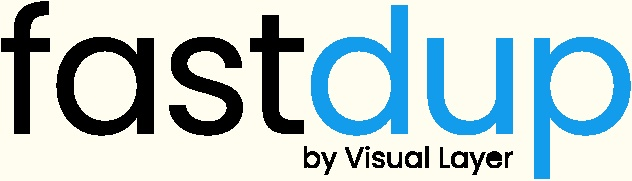
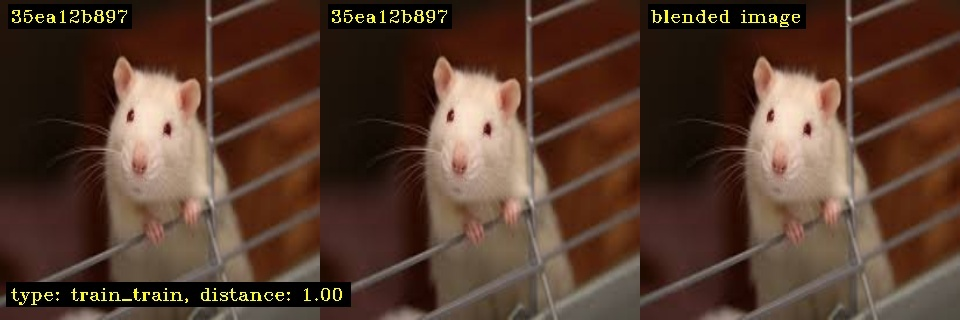
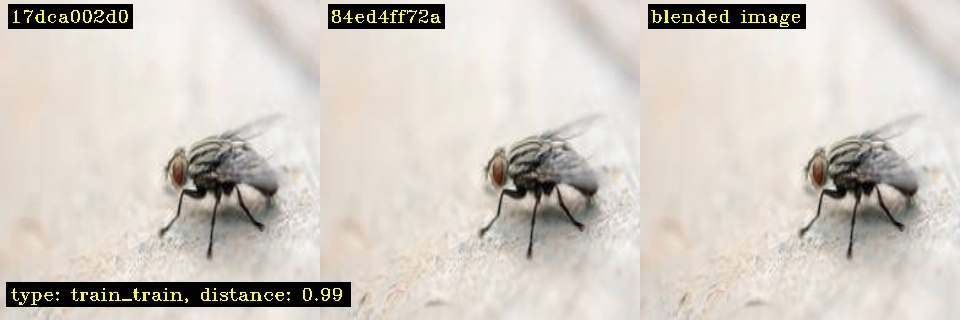
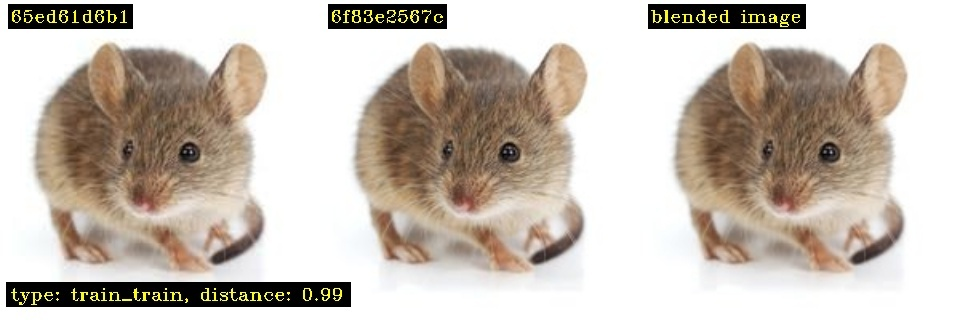
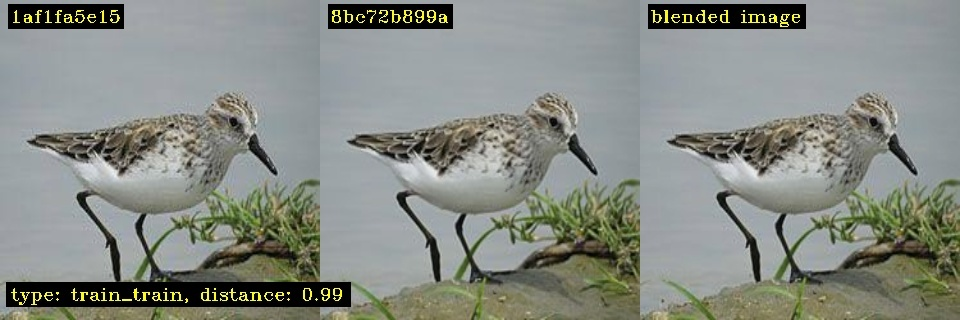
...
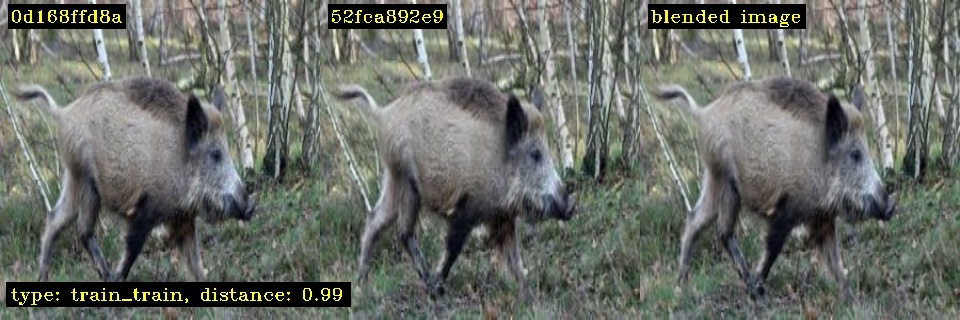
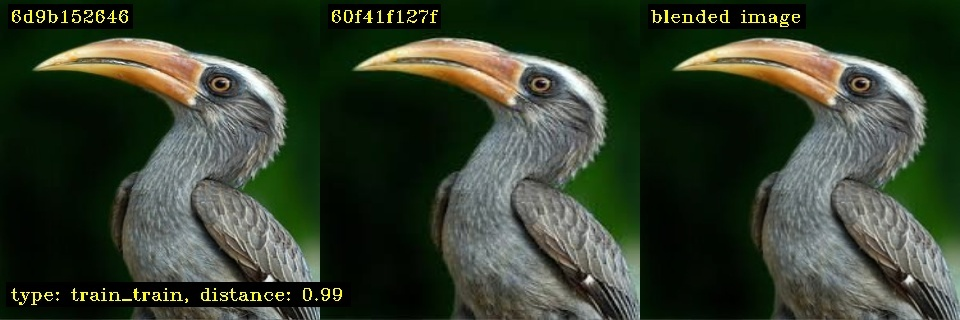
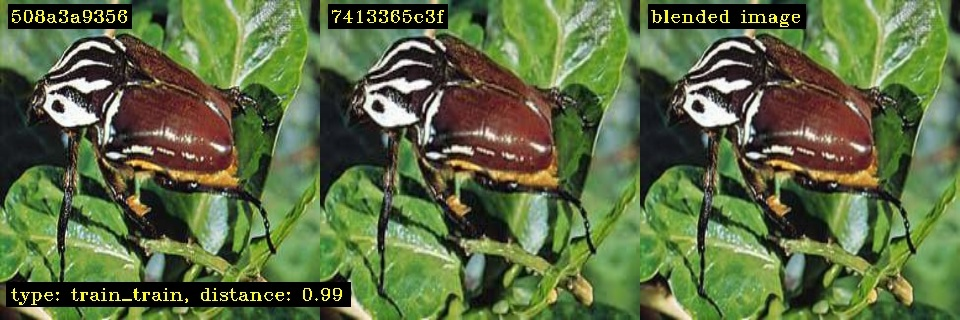
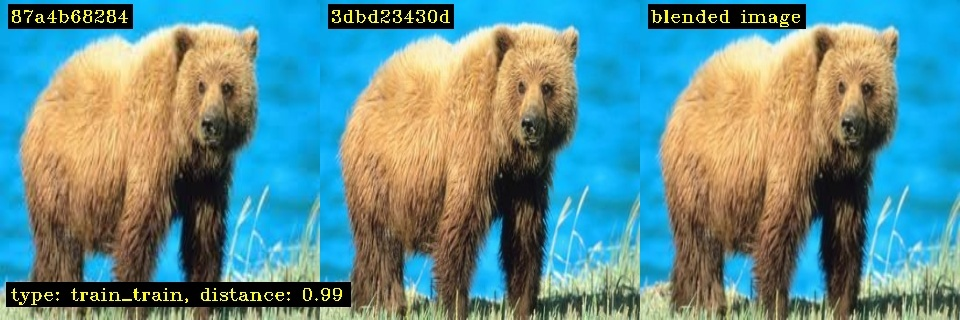
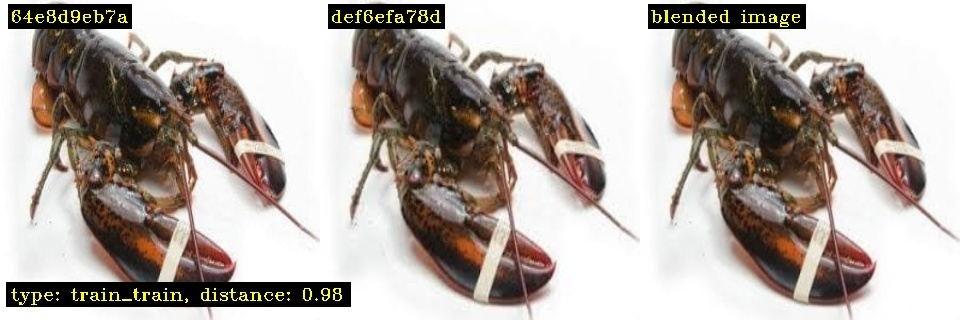

0

In [17]:
fd.vis.duplicates_gallery()

Generating gallery:   0%|          | 0/20 [00:00<?, ?it/s]

Finished OK. Components are stored as image files work_dir/galleries/components_[index].jpg
Stored components visual view in  work_dir/galleries/components.html
Execution time in seconds 0.5
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



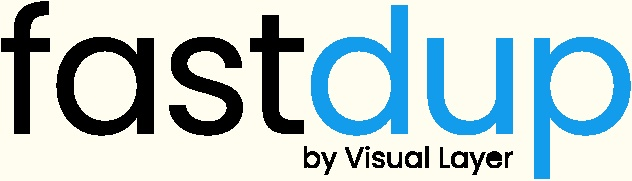
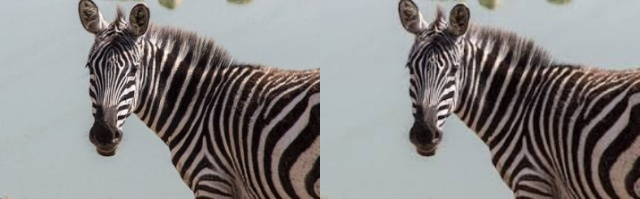
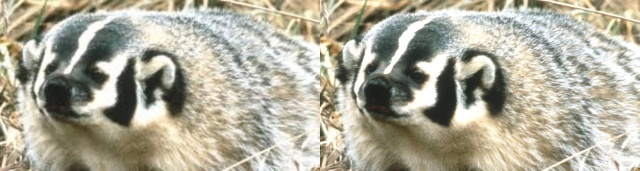
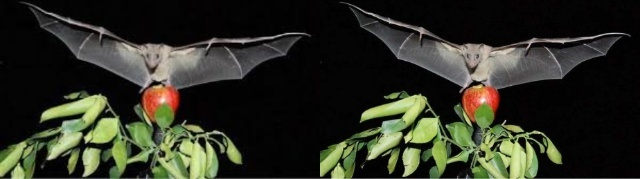
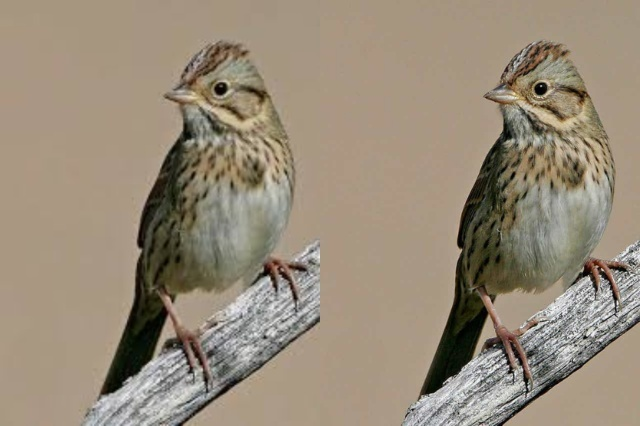
...
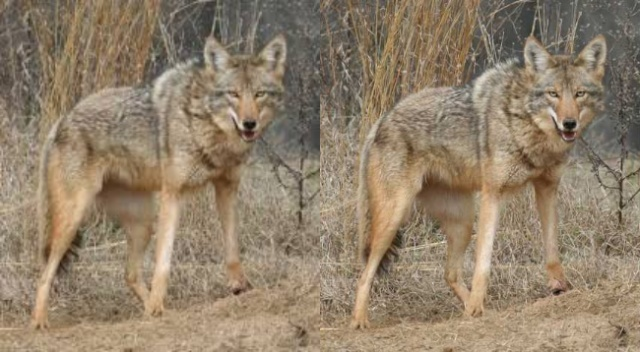
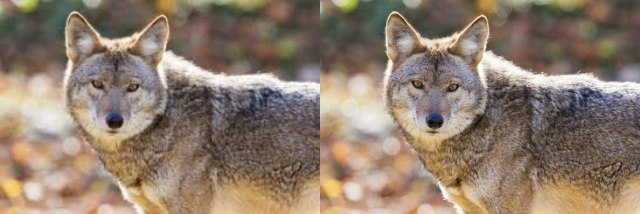
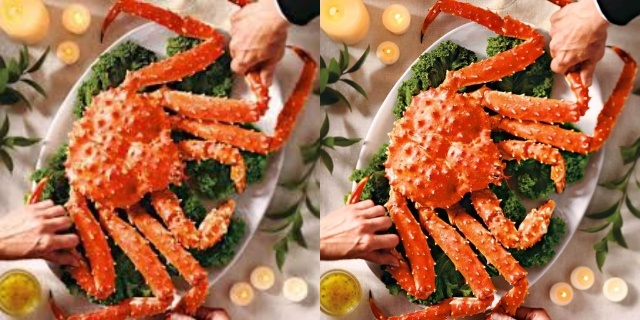
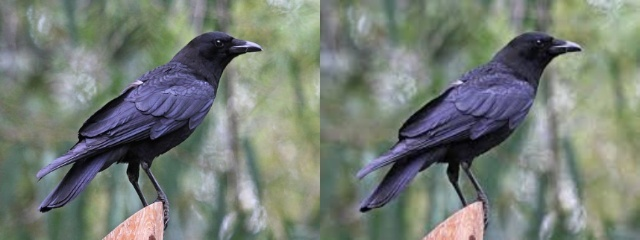
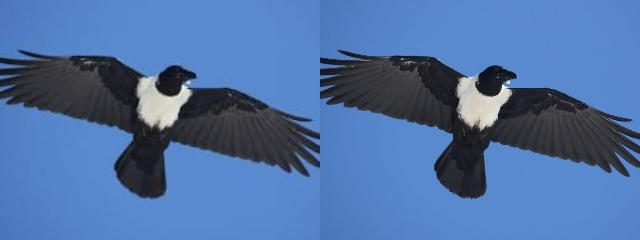

0

In [18]:
fd.vis.component_gallery()

## Outliers

Generating gallery:   0%|          | 0/20 [00:00<?, ?it/s]

Stored outliers visual view in  work_dir/galleries/outliers.html
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



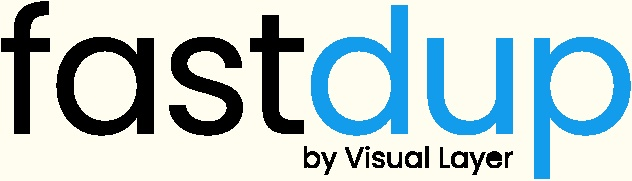
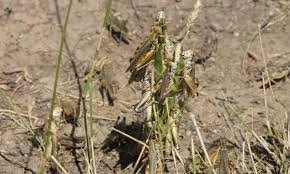
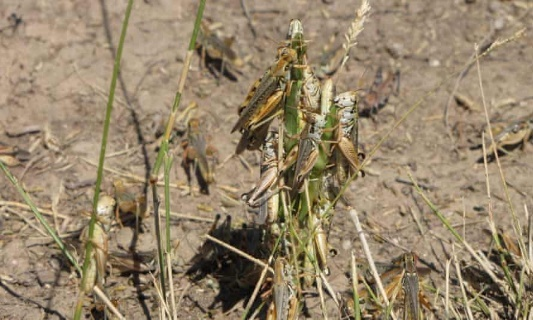
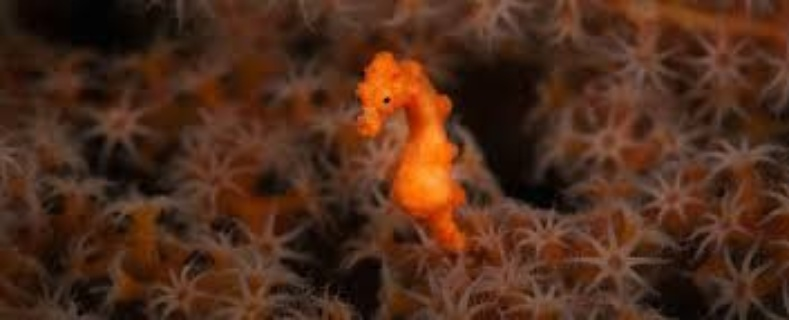
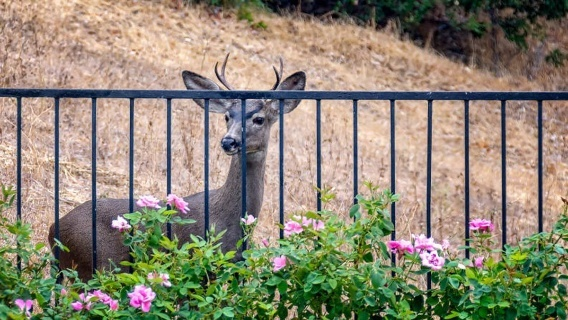
...
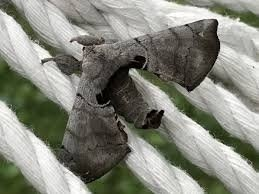
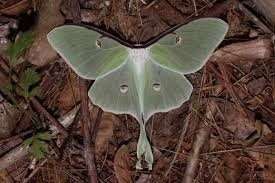
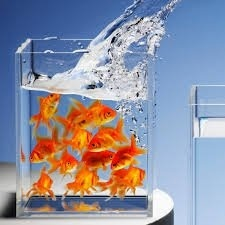
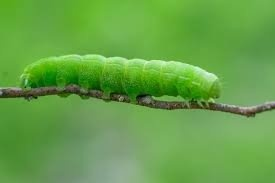
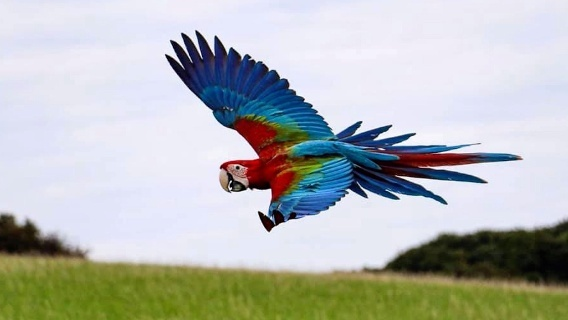

0

In [19]:
fd.vis.outliers_gallery() 

# Dark Images

Generating gallery:   0%|          | 0/20 [00:00<?, ?it/s]

Stored mean visual view in  work_dir/galleries/mean.html
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



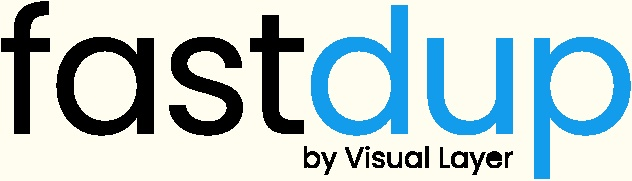
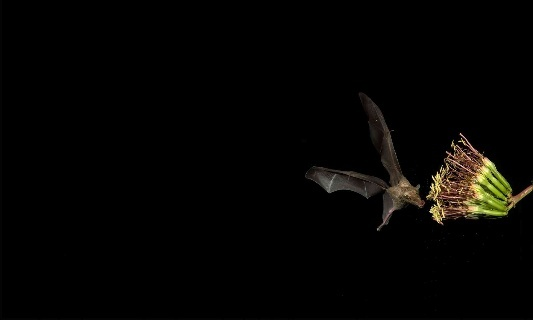
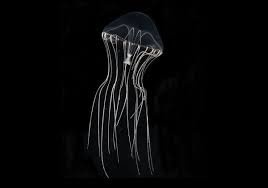
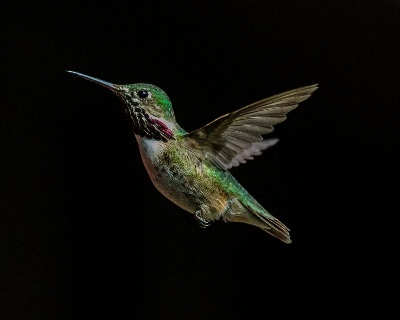
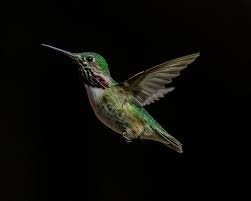
...
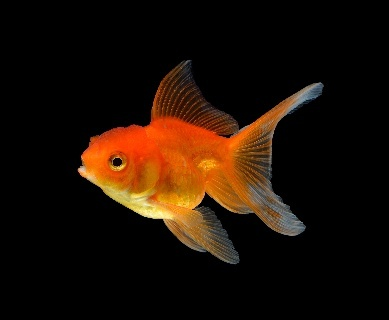
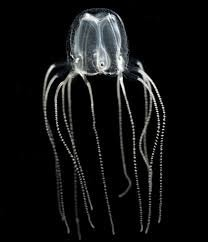
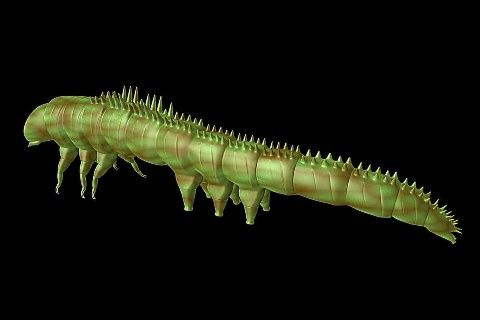
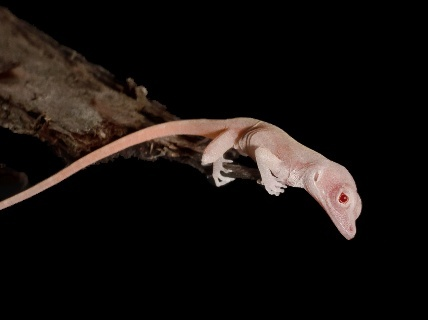
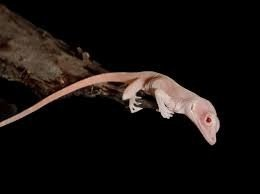

0

In [20]:
fd.vis.stats_gallery(metric='dark')

## Bright Images

Generating gallery:   0%|          | 0/20 [00:00<?, ?it/s]

Stored mean visual view in  work_dir/galleries/mean.html
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



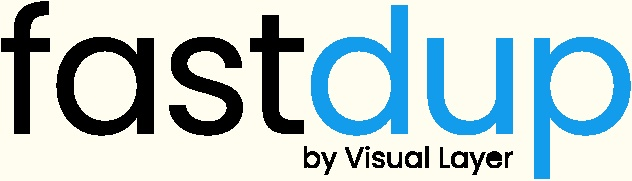
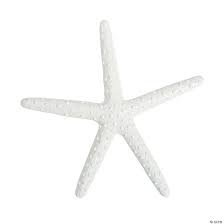
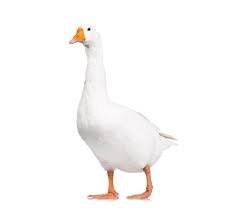
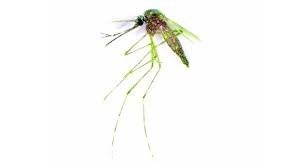
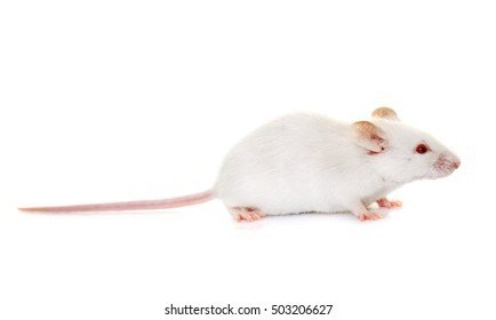
...
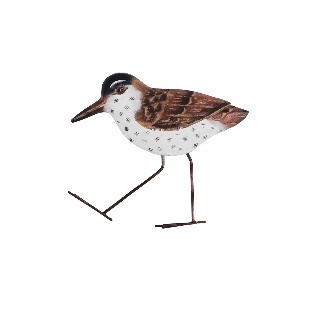
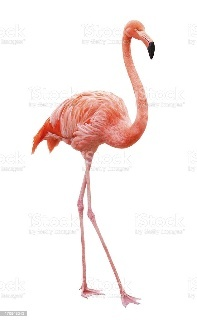
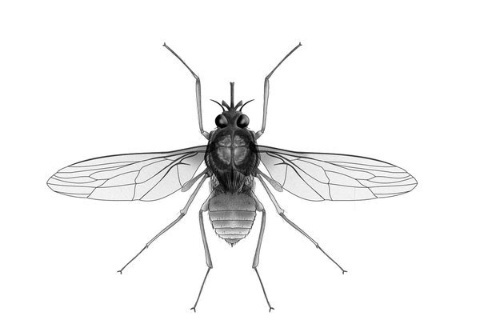
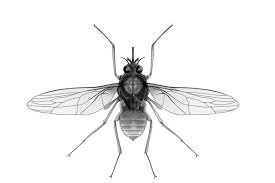
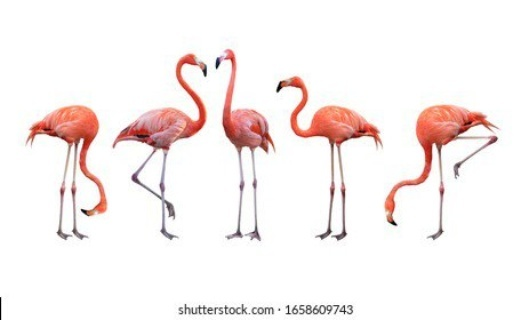

0

In [21]:
fd.vis.stats_gallery(metric='bright')

## Blur Images

Generating gallery:   0%|          | 0/20 [00:00<?, ?it/s]

Stored blur visual view in  work_dir/galleries/blur.html
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



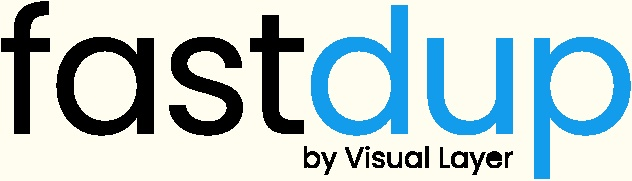
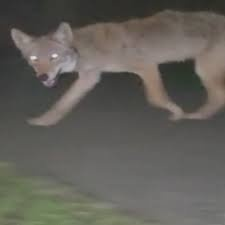
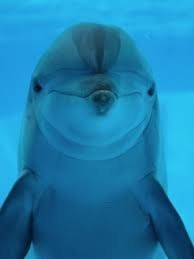
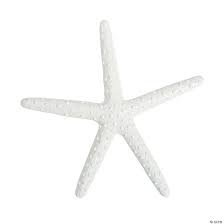
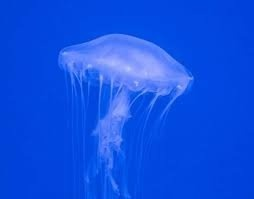
...
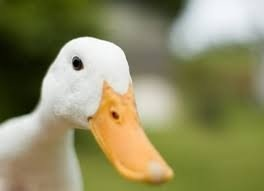
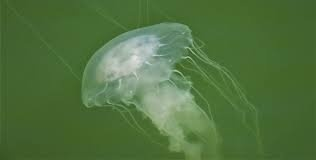
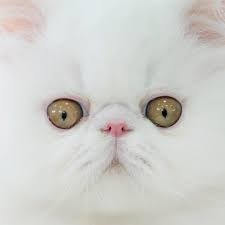
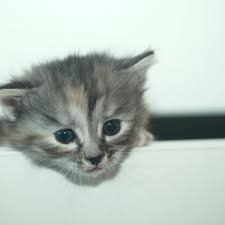
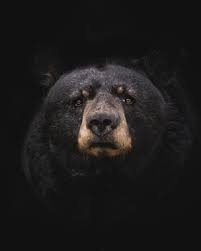

0

In [22]:
fd.vis.stats_gallery(metric='blur')

## Size Analysis

Generating gallery:   0%|          | 0/20 [00:00<?, ?it/s]

Stored size visual view in  work_dir/galleries/size.html
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



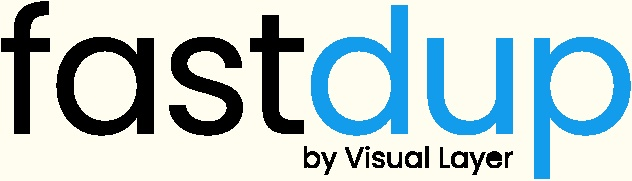
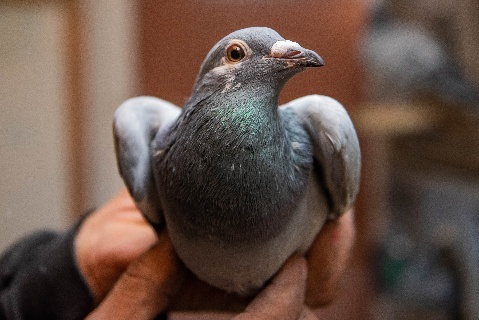
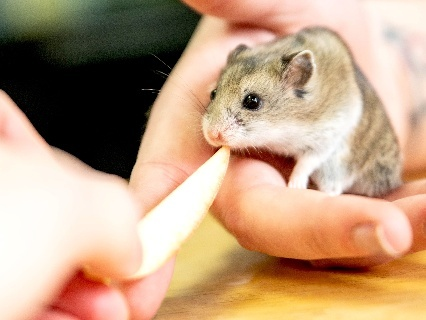
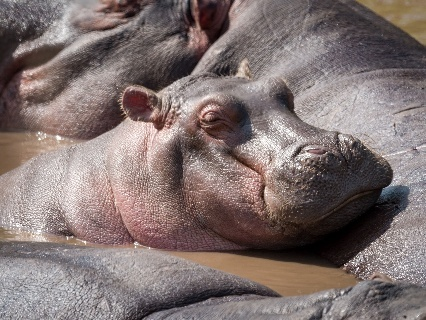
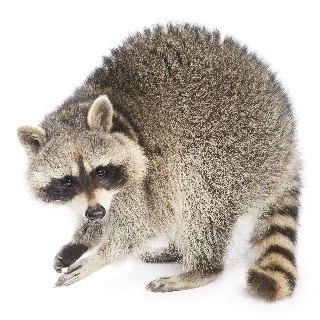
...
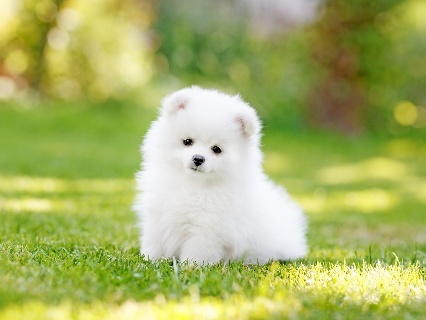
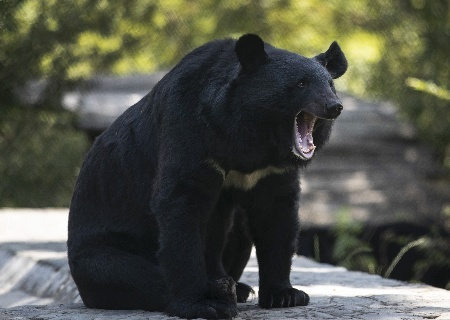
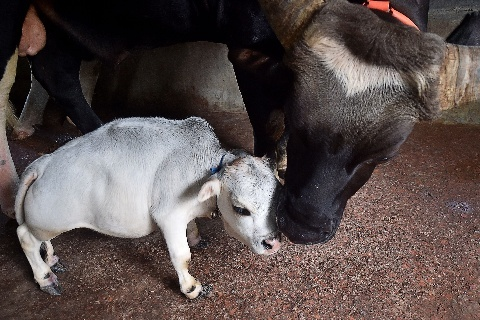
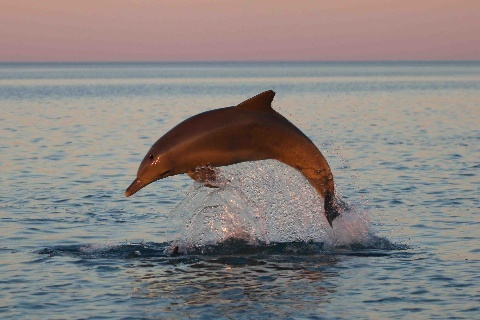
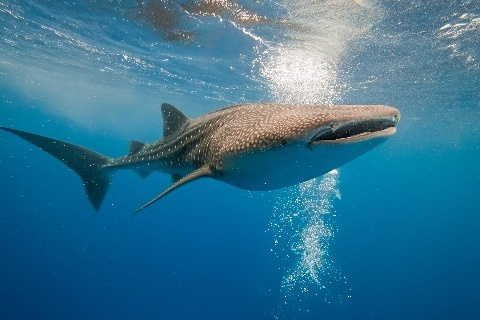

0

In [23]:
fd.vis.stats_gallery(metric='size')

## Contrast

Generating gallery:   0%|          | 0/20 [00:00<?, ?it/s]

Stored contrast visual view in  work_dir/galleries/contrast.html
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



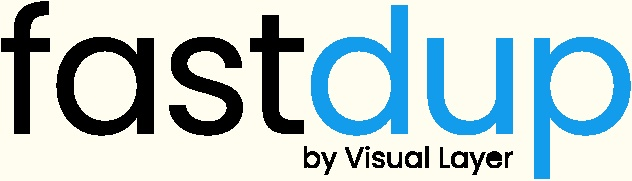
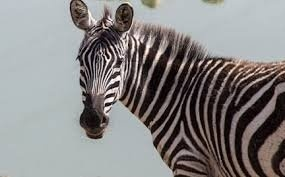
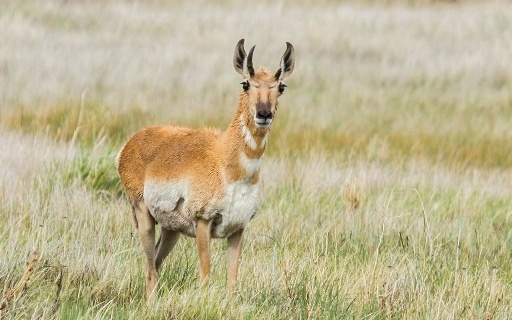
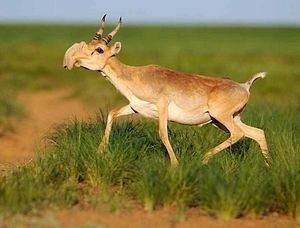
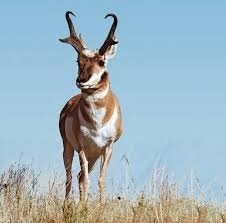
...
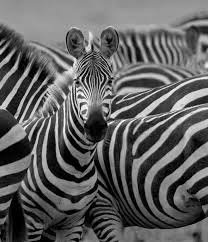
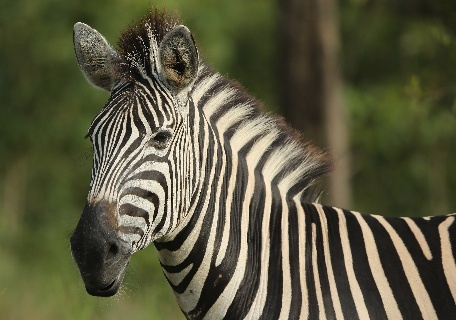
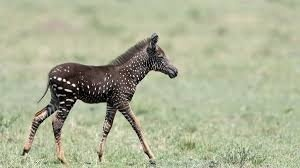
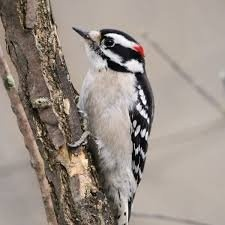
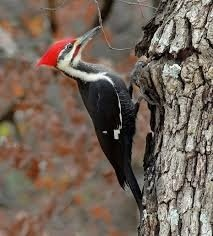

0

In [24]:
fd.vis.stats_gallery(metric='contrast')

# Train Test Split

In [25]:
def split_dataset(source_dir, target_dir, split=(0.7, 0.15, 0.15), seed=42):
    assert sum(split) == 1.0, "Split ratios must sum to 1.0"
    os.makedirs(target_dir, exist_ok=True)

    classes = [d for d in os.listdir(source_dir) if os.path.isdir(os.path.join(source_dir, d))]

    for cls in classes:
        src_cls_path = os.path.join(source_dir, cls)
        images = [f for f in os.listdir(src_cls_path) if os.path.isfile(os.path.join(src_cls_path, f))]

        train_imgs, temp_imgs = train_test_split(images, test_size=(1 - split[0]), random_state=seed)
        val_imgs, test_imgs = train_test_split(temp_imgs, test_size=split[2] / (split[1] + split[2]), random_state=seed)

        for split_name, img_list in zip(['train', 'val', 'test'], [train_imgs, val_imgs, test_imgs]):
            dest_dir = os.path.join(target_dir, split_name, cls)
            os.makedirs(dest_dir, exist_ok=True)
            for img in img_list:
                shutil.copy2(os.path.join(src_cls_path, img), os.path.join(dest_dir, img))


# Usage
split_dataset(
    source_dir='/kaggle/input/animal-image-dataset-90-different-animals/animals/animals',
    target_dir='data/land_animals_split'
)


# Model Training

In [26]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import transforms, datasets
import timm
import time
import copy
import pickle
from torch.cuda.amp import GradScaler, autocast
from torch.optim.lr_scheduler import CosineAnnealingLR


In [27]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [28]:
import random
import matplotlib.pyplot as plt
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    confusion_matrix, ConfusionMatrixDisplay, classification_report
)

In [29]:
class WildNetTrainer:
    def __init__(self, model, data_dir, device='cuda' if torch.cuda.is_available() else 'cpu',
                 image_size=224, batch_size=32):
        """
        Whenever an instace is created for this class, following operations will occur automatically:
        1. Move the model to device (cuda if it is available else cpu)
        2. Initialize device, data directory, image size, and batch size
        3. Create class to index mapping, initially none
        4. Create an empty dictory to track training history
        5. Apply required transformations on given data (found in data_dir directory)
        6. Load the data
        """
        self.model = model.to(device)
        self.device = device
        self.data_dir = data_dir
        self.image_size = image_size
        self.batch_size = batch_size
        self.class_to_idx = None
        self.best_epoch = None
        self.history = {}
        self._prepare_transforms()
        self._load_data()

    def _prepare_transforms(self):
        """
        This function applies some transformations on training and validation data.
        Transformations applied on training data are:
            - Resize so that all images have same size
            - RandomHorizontalFlip
            - RandomRotation
            - Color Jitter
            - Convert into tensor
            - Normalize values as per ImageNet stats

        Transformations applied on validation and testing data:
            - Resize to ensure that all images have same size
            - Convert into tensor
            - Normalize values as per ImageNet stats

        Note: We don't apply transformations like flipping, rotation, and jitter etc. to test data.
        """
        self.train_transform = transforms.Compose([
            transforms.Resize((self.image_size, self.image_size)),
            transforms.RandomHorizontalFlip(p=0.5),
            transforms.RandomRotation(degrees=15),
            transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
        ])
        self.val_test_transform = transforms.Compose([
            transforms.Resize((self.image_size, self.image_size)),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
        ])

    def _load_data(self):
        """
        Loads the train, validation, and test datasets from the given directory, 
        applies the appropriate transformations, and creates corresponding DataLoaders.
        Also stores the class-to-index mapping from the training set.
        """
        train_path = os.path.join(self.data_dir, 'train')
        val_path = os.path.join(self.data_dir, 'val')
        test_path = os.path.join(self.data_dir, 'test')

        self.train_dataset = datasets.ImageFolder(train_path, transform=self.train_transform)
        self.val_dataset = datasets.ImageFolder(val_path, transform=self.val_test_transform)
        self.test_dataset = datasets.ImageFolder(test_path, transform=self.val_test_transform)

        self.train_loader = DataLoader(self.train_dataset, batch_size=self.batch_size, shuffle=True, num_workers=2, drop_last=True)
        self.val_loader = DataLoader(self.val_dataset, batch_size=self.batch_size, shuffle=False, num_workers=2)
        self.test_loader = DataLoader(self.test_dataset, batch_size=self.batch_size, shuffle=False, num_workers=2)

        self.class_to_idx = self.train_dataset.class_to_idx

    def set_seed(self, seed=42):
        """
        Sets the random seed for reproducibility across PyTorch, NumPy, and Python random module.
        Args:
        seed (int): The seed value to set.
    """
        torch.manual_seed(seed)
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)
        np.random.seed(seed)
        random.seed(seed)
        torch.backends.cudnn.deterministic = True
        torch.backends.cudnn.benchmark = False

    def evaluate(self, loader):
        """
        Evaluates the model's classification accuracy on the given DataLoader.
        Args:
            loader (DataLoader): The DataLoader (train/val/test) to evaluate on.
        Returns:
            float: Classification accuracy (0–1).
        """
        self.model.eval()
        correct, total = 0, 0
        with torch.no_grad():
            for images, labels in loader:
                images, labels = images.to(self.device), labels.to(self.device)
                outputs = self.model(images)
                _, preds = torch.max(outputs, 1)
                correct += (preds == labels).sum().item()
                total += labels.size(0)
        return correct / total

    def compute_macro_metrics(self, loader):
        """
        Computes macro-averaged precision, recall, and F1 score for the given DataLoader.
        Args:
            loader (DataLoader): The DataLoader (train/val/test) to evaluate on.
        Returns:
            tuple: (precision, recall, f1), each a float between 0 and 1.
        """
        self.model.eval()
        all_preds, all_labels = [], []
        with torch.no_grad():
            for images, labels in loader:
                images, labels = images.to(self.device), labels.to(self.device)
                outputs = self.model(images)
                _, preds = torch.max(outputs, 1)
                all_preds.extend(preds.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())

        precision = precision_score(all_labels, all_preds, average='macro', zero_division=0)
        recall = recall_score(all_labels, all_preds, average='macro', zero_division=0)
        f1 = f1_score(all_labels, all_preds, average='macro', zero_division=0)
        return precision, recall, f1

    def train(self, criterion, optimizer, save_path='models/best_model.pth', epochs=100, patience=5):
        """
        Trains the model using the training DataLoader with early stopping based on validation macro F1 score.
        Args:
            criterion: Loss function (e.g., nn.CrossEntropyLoss).
            optimizer: Optimizer (e.g., torch.optim.Adam).
            save_path (str): Path to save the best-performing model.
            epochs (int): Maximum number of epochs to train.
            patience (int): Number of epochs to wait without improvement before stopping.
        Returns:
            dict: A history dictionary containing training and validation metrics over epochs.
        """
        self.set_seed()
        os.makedirs("models", exist_ok=True)
        best_f1 = 0.0
        epochs_no_improve = 0
        self.best_epoch = 0

        history = {
            'train_loss': [],
            'train_acc': [],
            'val_acc': [],
            'val_precision': [],
            'val_recall': [],
            'val_f1': []
        }

        for epoch in range(epochs):
            self.model.train()
            running_loss, correct, total = 0.0, 0, 0

            for images, labels in self.train_loader:
                images, labels = images.to(self.device), labels.to(self.device)
                optimizer.zero_grad()
                outputs = self.model(images)
                loss = criterion(outputs, labels)
                loss.backward()
                optimizer.step()

                running_loss += loss.item() * images.size(0)
                _, preds = torch.max(outputs, 1)
                correct += (preds == labels).sum().item()
                total += labels.size(0)

            train_loss = running_loss / total
            train_acc = correct / total
            val_acc = self.evaluate(self.val_loader)
            val_precision, val_recall, val_f1 = self.compute_macro_metrics(self.val_loader)

            print(f"Epoch [{epoch+1}/{epochs}] - Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, Val Acc: {val_acc:.4f}, Val F1: {val_f1:.4f}")

            history['train_loss'].append(train_loss)
            history['train_acc'].append(train_acc)
            history['val_acc'].append(val_acc)
            history['val_precision'].append(val_precision)
            history['val_recall'].append(val_recall)
            history['val_f1'].append(val_f1)

            if val_f1 > best_f1:
                best_f1 = val_f1
                self.best_epoch = epoch
                torch.save(self.model.state_dict(), save_path)
                epochs_no_improve = 0
                print("Validation F1 improved. Model saved.")
            else:
                epochs_no_improve += 1
                print(f"No improvement for {epochs_no_improve} epoch(s).")

            if epochs_no_improve >= patience:
                print("Early stopping triggered.")
                break

        self.history = history
        return history

    def save_pickle(self, filename="models/model_history.pkl"):
        """
        Saves the trained model and training history as a pickle file.
        Args:
            filename (str): Path to save the pickle file.
        """
        with open(filename, "wb") as f:
            pickle.dump(self.model, f)
            pickle.dump(self.history, f)
            pickle.dump(self.best_epoch, f)
            pickle.dump(self.summary, f)

    def visualize_training(self):
        """
        Plots training and validation accuracy, as well as training loss, across epochs.
        """
        if not self.history:
            print("No training history found.")
            return

        plt.figure(figsize=(8, 5))
        plt.plot(self.history['train_acc'], label='Train Accuracy')
        plt.plot(self.history['val_acc'], label='Validation Accuracy')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.title('Train vs Val Accuracy')
        plt.legend()
        plt.grid(True)
        plt.show()

        plt.figure(figsize=(8, 5))
        plt.plot(self.history['train_loss'], label='Train Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training Loss')
        plt.legend()
        plt.grid(True)
        plt.show()

    def get_predictions(self, loader):
        """
        Gets model predictions and true labels for the given DataLoader.
        Args:
            loader (DataLoader): The DataLoader (train/val/test) to evaluate on.
        Returns:
            tuple: (predictions, true_labels) as NumPy arrays.
        """
        self.model.eval()
        all_preds, all_labels = [], []
        with torch.no_grad():
            for images, labels in loader:
                images, labels = images.to(self.device), labels.to(self.device)
                outputs = self.model(images)
                _, preds = torch.max(outputs, 1)
                all_preds.extend(preds.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())
        return np.array(all_preds), np.array(all_labels)

    def predict(self, images):
        """
        Predict labels for one or more images (PIL.Image or list of PIL.Images).
        Args:
            images (PIL.Image.Image or list[PIL.Image.Image])
        Returns:
            list of (class_name, probability)
        """
        if not isinstance(images, list):
            images = [images]
    
        self.model.eval()
        results = []
        idx_to_class = {v: k for k, v in self.class_to_idx.items()}
    
        for img in images:
            if not isinstance(img, Image.Image):  # in case a path was passed
                img = Image.open(img).convert("RGB")
            else:
                img = img.convert("RGB")
    
            tensor = self.val_test_transform(img).unsqueeze(0).to(self.device)
    
            with torch.no_grad():
                outputs = self.model(tensor)
                probs = torch.softmax(outputs, dim=1)
                top_prob, pred_idx = torch.max(probs, 1)
    
            results.append((idx_to_class[pred_idx.item()], top_prob.item()))
    
        return results


    def evaluate_on_test(self):
        """
        Evaluates the model on the test set and displays:
        - Confusion matrix
        - Classification report
        - Macro and micro precision, recall, and F1 scores
    
        Stores the computed metrics in `self.test_metrics`.
        """
        y_pred, y_true = self.get_predictions(self.test_loader)
        class_names = self.test_dataset.classes

        self.test_metrics = {
            'accuracy': accuracy_score(y_true, y_pred),
            'macro_precision': precision_score(y_true, y_pred, average='macro', zero_division=0),
            'macro_recall': recall_score(y_true, y_pred, average='macro', zero_division=0),
            'macro_f1': f1_score(y_true, y_pred, average='macro', zero_division=0),
            'micro_precision': precision_score(y_true, y_pred, average='micro'),
            'micro_recall': recall_score(y_true, y_pred, average='micro'),
            'micro_f1': f1_score(y_true, y_pred, average='micro')
        }

        cm = confusion_matrix(y_true, y_pred)
        disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
        fig, ax = plt.subplots(figsize=(12, 12))
        disp.plot(ax=ax, xticks_rotation='vertical', cmap='Blues')
        plt.title("Confusion Matrix - Test Set")
        plt.tight_layout()
        plt.show()

        print("Classification Report:")
        print(classification_report(y_true, y_pred, target_names=class_names))

    def get_summary(self):
        """
        Returns a dictionary summarizing training, validation, and test metrics 
        for comparison and reporting.
    
        Returns:
            dict: Summary of accuracy, precision, recall, and F1 score across splits.
        """

        self.summary = {
            'Train Accuracy': self.history['train_acc'][self.best_epoch],
            'Val Accuracy': self.history['val_acc'][self.best_epoch],
            'Val Precision': self.history['val_precision'][self.best_epoch],
            'Val Recall': self.history['val_recall'][self.best_epoch],
            'Val F1': self.history['val_f1'][self.best_epoch]
        }
        if hasattr(self, 'test_metrics'):
            self.summary.update({
                'Test Accuracy': self.test_metrics['accuracy'],
                'Test Precision': self.test_metrics['macro_precision'],
                'Test Recall': self.test_metrics['macro_recall'],
                'Test F1': self.test_metrics['macro_f1']
            })
        return self.summary


In [30]:
import warnings

warnings.filterwarnings('ignore')

# ResNet

## Training

In [31]:
from torchvision import models

In [32]:
pkl_path = "/kaggle/working/models/WildResnet.pkl"  

if os.path.exists(pkl_path):
    print("Pickle file found. Loading model and history...")

    with open(pkl_path, "rb") as f:
        resnet_model = pickle.load(f)               
        resnet_history = pickle.load(f)  
        resnet_best_epoch = pickle.load(f)
        # resnet_summary = pickle.load(f)

    # Optionally re-wrap the model with WildNetTrainer to access dataloaders
    resnet_trainer = WildNetTrainer(
        model=resnet_model,
        data_dir="/kaggle/working/data/land_animals_split",
        device='cuda' if torch.cuda.is_available() else 'cpu',
        image_size=224,
        batch_size=32
    )
    resnet_trainer.history = resnet_history
    resnet_trainer.best_epoch = resnet_best_epoch
    print("Model and history loaded.")

else:
    print("No pickle found. Training model from scratch...")

    # Step 1: Load num_classes
    train_path = "/kaggle/working/data/land_animals_split/train"
    train_dataset = datasets.ImageFolder(train_path)
    num_classes = len(train_dataset.classes)

    # Step 2: Define model
    resnet_model = models.resnet50(pretrained=True)
    for param in resnet_model.parameters():
        param.requires_grad = False
    resnet_model.fc = nn.Linear(resnet_model.fc.in_features, num_classes)

    # Step 3: Train
    resnet_trainer = WildNetTrainer(
        model=resnet_model,
        data_dir="/kaggle/working/data/land_animals_split",
        device='cuda' if torch.cuda.is_available() else 'cpu',
        image_size=224,
        batch_size=32
    )

    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(resnet_model.fc.parameters(), lr=1e-2)

    resnet_history = resnet_trainer.train(
        criterion=criterion,
        optimizer=optimizer,
        save_path="models/resnet50_model.pth",
        epochs=100,
        patience=7
    )

    # Step 4: Save to pickle
    # resnet_trainer.save_pickle("models/resnet50_model.pkl")


Pickle file found. Loading model and history...
Model and history loaded.


## Visualize Training

In [33]:
resnet_trainer.model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

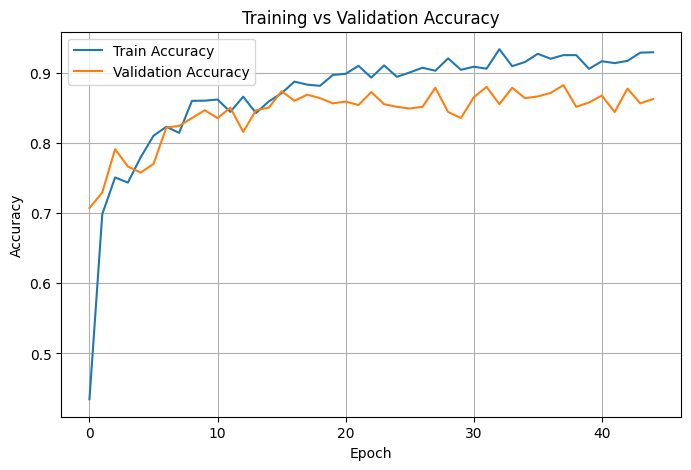

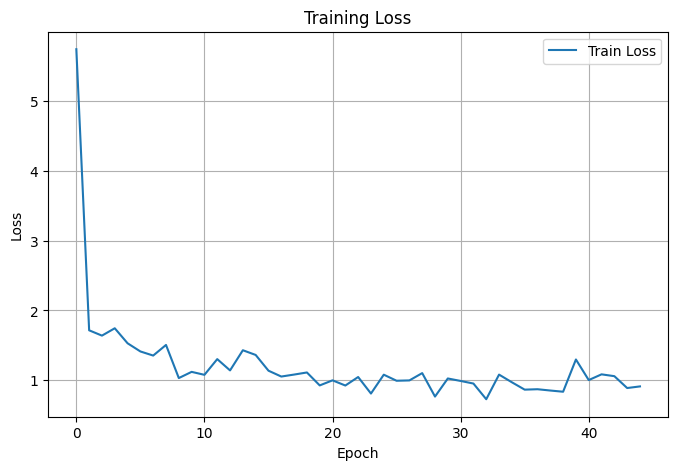

In [34]:
def visualize_acc_loss(history):
    # Accuracy
    plt.figure(figsize=(8, 5))
    plt.plot(history['train_acc'], label='Train Accuracy')
    plt.plot(history['val_acc'], label='Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Training vs Validation Accuracy')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Loss
    plt.figure(figsize=(8, 5))
    plt.plot(history['train_loss'], label='Train Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.legend()
    plt.grid(True)
    plt.show()


visualize_acc_loss(resnet_history)

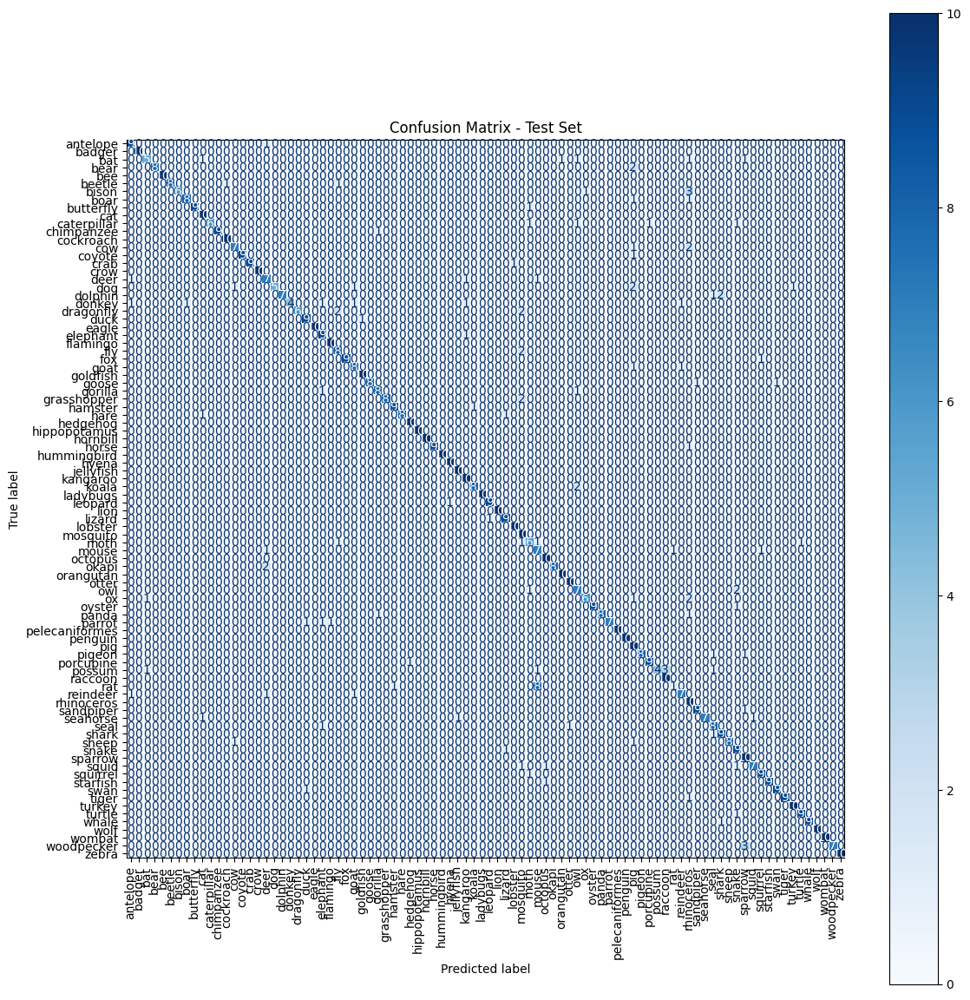

Classification Report:
                precision    recall  f1-score   support

      antelope       0.75      0.90      0.82        10
        badger       1.00      1.00      1.00        10
           bat       0.71      0.50      0.59        10
          bear       1.00      0.80      0.89        10
           bee       1.00      1.00      1.00        10
        beetle       1.00      0.80      0.89        10
         bison       1.00      0.60      0.75        10
          boar       0.89      0.80      0.84        10
     butterfly       1.00      0.90      0.95        10
           cat       0.77      1.00      0.87        10
   caterpillar       1.00      0.60      0.75        10
    chimpanzee       1.00      0.90      0.95        10
     cockroach       0.91      1.00      0.95        10
           cow       0.78      0.70      0.74        10
        coyote       1.00      0.90      0.95        10
          crab       1.00      0.90      0.95        10
          crow       1.0

In [35]:
resnet_trainer.evaluate_on_test()

# Prediction

In [36]:
from PIL import Image

In [37]:
img1 = Image.open('/kaggle/working/data/land_animals_split/val/bear/0e6a8744de.jpg')
img2 = Image.open('/kaggle/working/data/land_animals_split/val/bear/4286c87550.jpg')
img = [img1, img2]
resnet_trainer.predict(img)

[('jellyfish', 0.6617823839187622), ('bear', 0.9991818070411682)]

In [38]:
resnet_trainer.get_summary()

{'Train Accuracy': 0.9255434782608696,
 'Val Accuracy': 0.8827160493827161,
 'Val Precision': 0.9038518223167346,
 'Val Recall': 0.8827160493827161,
 'Val F1': 0.8796700443299358,
 'Test Accuracy': 0.8511111111111112,
 'Test Precision': 0.8812201378868045,
 'Test Recall': 0.8511111111111112,
 'Test F1': 0.8504460013703744}

In [39]:
img = []
true_labels = ['bee', 'badger', 'antelope', 'chimpanzee', 'fox', 'kangaroo']
pred_labels = []

paths = ['/kaggle/working/data/land_animals_split/test/bee/160cdad8e6.jpg',
         '/kaggle/working/data/land_animals_split/test/badger/14d27983c0.jpg',
         '/kaggle/working/data/land_animals_split/test/antelope/0ee903ea13.jpg',
         '/kaggle/working/data/land_animals_split/test/chimpanzee/05ffb1984e.jpg',
         '/kaggle/working/data/land_animals_split/test/fox/2d70da21cb.jpg',
         '/kaggle/working/data/land_animals_split/test/kangaroo/09d0fdaadd.jpg'
        ]

for path in paths:
    temp = Image.open(path)
    img.append(temp)
    pred = resnet_trainer.predict(temp)
    pred_labels.append(pred[0][0])

df = pd.DataFrame({
    "True": true_labels,
    "Pred": pred_labels
})
df["Correct"] = df["True"] == df["Pred"]
df

,True,Pred,Correct
0,bee,bee,True
1,badger,badger,True
2,antelope,antelope,True
3,chimpanzee,chimpanzee,True
4,fox,fox,True
5,kangaroo,kangaroo,True


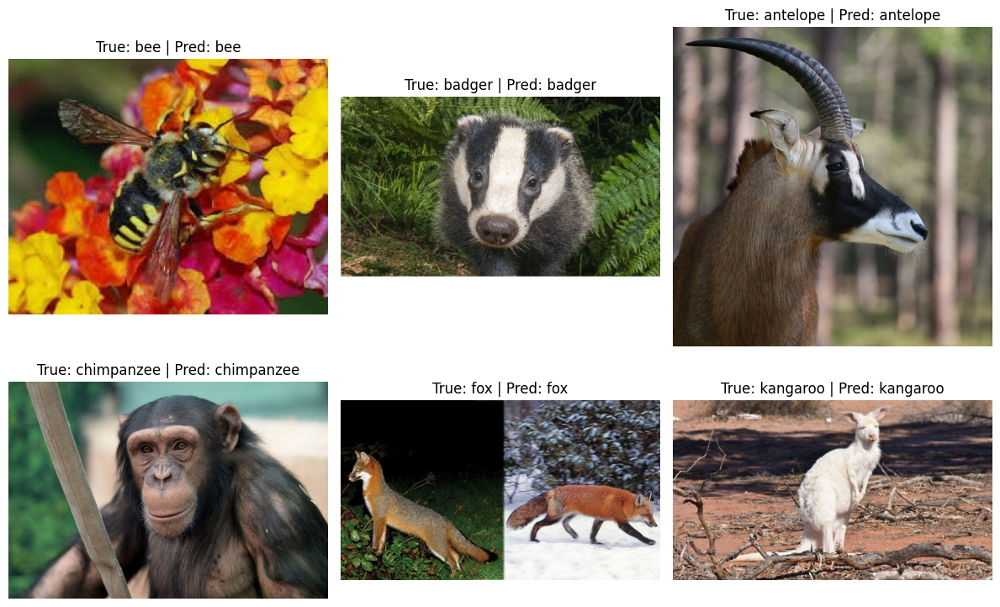

In [40]:
fig, axes = plt.subplots(2, 3, figsize=(12, 8))
k = 0

for i in range(2):
    for j in range(3):
        axes[i,j].imshow(img[k])
        axes[i,j].set_title(f"True: {true_labels[k]} | Pred: {pred_labels[k]}")
        axes[i,j].axis('off')
        k += 1

plt.tight_layout()
plt.show()


In [41]:
# resnet_trainer.save_pickle('models/WildResnet.pkl')

# ConvNext Model

In [42]:
from torchvision.models import convnext_tiny

In [43]:
pkl_path = "/kaggle/working/models/WildConvnet.pkl"  

if os.path.exists(pkl_path):
    print("Pickle file found. Loading model and history...")

    with open(pkl_path, "rb") as f:
        conv_model = pickle.load(f)               
        conv_history = pickle.load(f)  
        conv_best_epoch = pickle.load(f)
        conv_summary = pickle.load(f)

    # Optionally re-wrap the model with WildNetTrainer to access dataloaders
    conv_trainer = WildNetTrainer(
        model=conv_model,
        data_dir="/kaggle/working/data/land_animals_split",
        device='cuda' if torch.cuda.is_available() else 'cpu',
        image_size=224,
        batch_size=32
    )
    conv_trainer.history = conv_history
    conv_trainer.best_epoch = conv_best_epoch
    print("Model and history loaded.")

else:
    print("No pickle found. Training model from scratch...")

    # Step 1: Load num_classes
    train_path = "/kaggle/working/data/land_animals_split/train"
    train_dataset = datasets.ImageFolder(train_path)
    num_classes = len(train_dataset.classes)

    # Step 2: Define model
    # BATCH_SIZE = 32

    conv_model = convnext_tiny(pretrained=True)
    conv_model.classifier[2] = nn.Linear(conv_model.classifier[2].in_features, num_classes)
    conv_model = conv_model.to(device)

    # Step 3: Train
    conv_trainer = WildNetTrainer(
        model=conv_model,
        data_dir="/kaggle/working/data/land_animals_split",
        device='cuda' if torch.cuda.is_available() else 'cpu',
        image_size=224,
        batch_size=32
    )

    criterion = nn.CrossEntropyLoss()
    optimizer = optim.AdamW(conv_model.parameters(), lr=1e-4, weight_decay=0.01)

    conv_history = conv_trainer.train(
        criterion=criterion,
        optimizer=optimizer,
        save_path="models/WildConvnext.pth",
        epochs=100,
        patience=7
    )

    # Step 4: Save to pickle
    # conv_trainer.save_pickle("models/convnext_tiny_model.pkl")


Pickle file found. Loading model and history...
Model and history loaded.


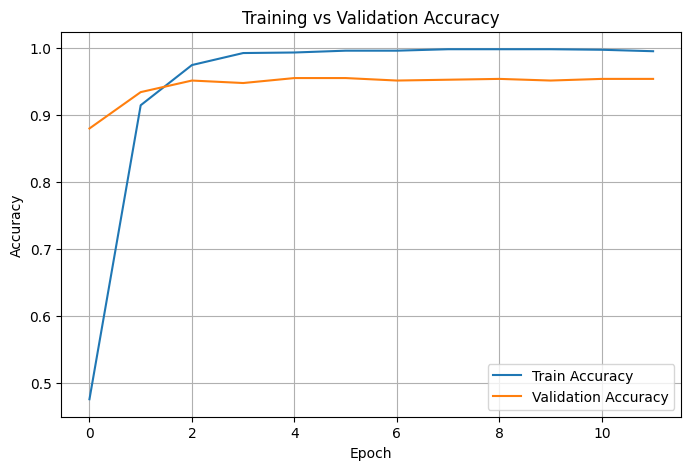

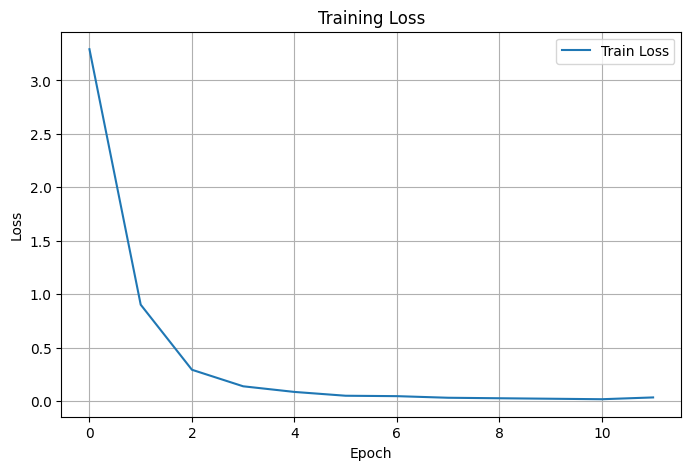

In [44]:
visualize_acc_loss(conv_history)

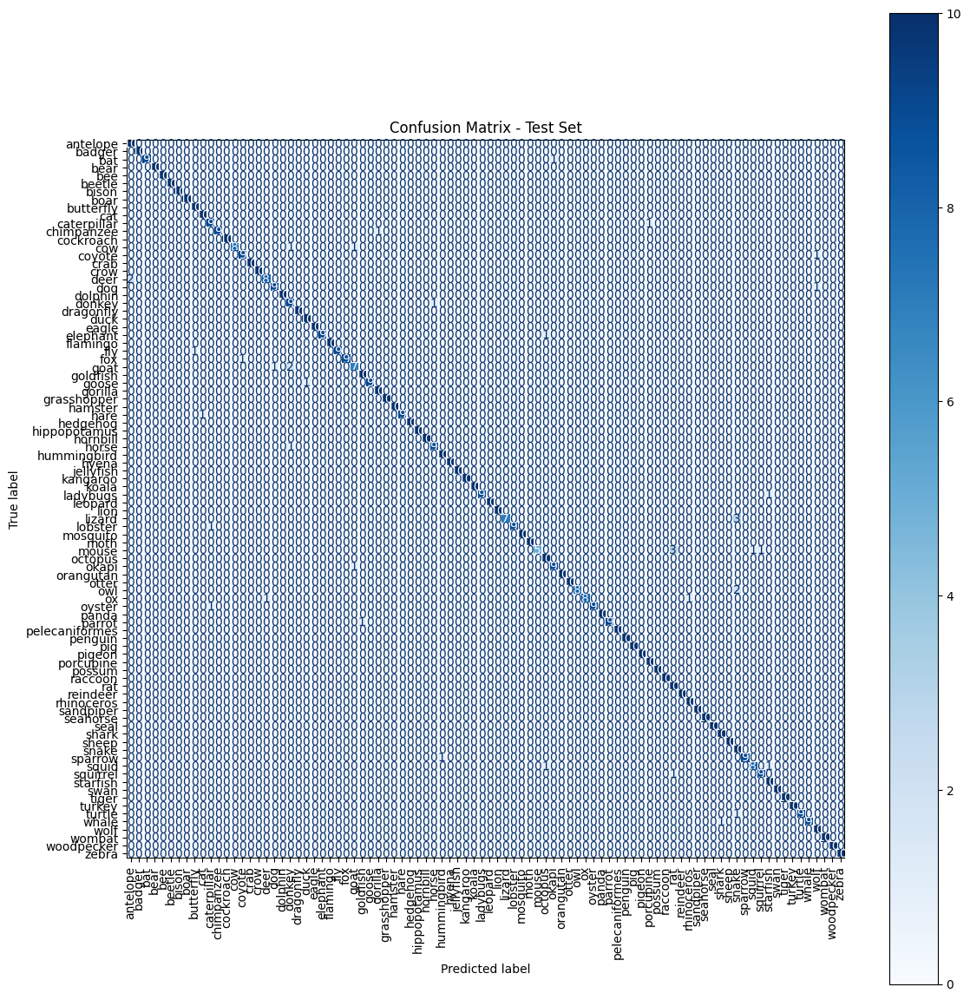

Classification Report:
                precision    recall  f1-score   support

      antelope       0.83      1.00      0.91        10
        badger       1.00      1.00      1.00        10
           bat       1.00      0.90      0.95        10
          bear       1.00      1.00      1.00        10
           bee       1.00      1.00      1.00        10
        beetle       1.00      1.00      1.00        10
         bison       1.00      1.00      1.00        10
          boar       1.00      1.00      1.00        10
     butterfly       0.91      1.00      0.95        10
           cat       0.91      1.00      0.95        10
   caterpillar       0.82      0.90      0.86        10
    chimpanzee       1.00      0.90      0.95        10
     cockroach       1.00      1.00      1.00        10
           cow       1.00      0.80      0.89        10
        coyote       0.90      0.90      0.90        10
          crab       1.00      1.00      1.00        10
          crow       1.0

In [45]:
conv_trainer.evaluate_on_test()

In [46]:
from PIL import Image

img1 = Image.open('/kaggle/working/data/land_animals_split/val/bear/0e6a8744de.jpg')
img2 = Image.open('/kaggle/working/data/land_animals_split/val/bear/4286c87550.jpg')
img = [img1, img2]
conv_trainer.predict(img)

[('lion', 0.14390471577644348), ('bear', 0.9789685010910034)]

In [47]:
conv_trainer.get_summary()

{'Train Accuracy': 0.99375,
 'Val Accuracy': 0.9555555555555556,
 'Val Precision': 0.961237959571293,
 'Val Recall': 0.9555555555555556,
 'Val F1': 0.95574884800633,
 'Test Accuracy': 0.9533333333333334,
 'Test Precision': 0.9602275810609143,
 'Test Recall': 0.9533333333333335,
 'Test F1': 0.9532353459396129}

In [48]:
img = []
true_labels = ['bat', 'badger', 'antelope', 'chimpanzee', 'coyote', 'elephant']
pred_labels = []

paths = ['/kaggle/working/data/land_animals_split/test/bat/499be57e10.jpg',
         '/kaggle/working/data/land_animals_split/test/badger/0c29e0107f.jpg',
         '/kaggle/working/data/land_animals_split/test/antelope/24b29ea96e.jpg',
         '/kaggle/working/data/land_animals_split/test/chimpanzee/00981a3b70.jpg',
         '/kaggle/working/data/land_animals_split/test/coyote/4ebd97228c.jpg',
         '/kaggle/working/data/land_animals_split/test/elephant/032ef781ef.jpg'
        ]

for path in paths:
    temp = Image.open(path)
    img.append(temp)
    pred = conv_trainer.predict(temp)
    pred_labels.append(pred[0][0])

df = pd.DataFrame({
    "True": true_labels,
    "Pred": pred_labels
})
df["Correct"] = df["True"] == df["Pred"]
df


,True,Pred,Correct
0,bat,bat,True
1,badger,badger,True
2,antelope,antelope,True
3,chimpanzee,chimpanzee,True
4,coyote,coyote,True
5,elephant,elephant,True


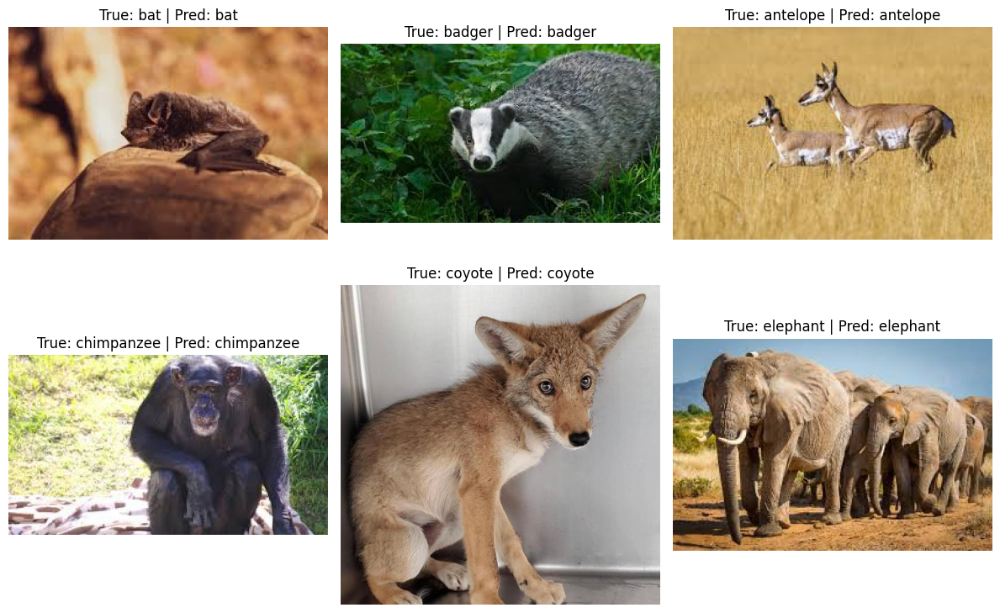

In [49]:
fig, axes = plt.subplots(2, 3, figsize=(12, 8))
k = 0

for i in range(2):
    for j in range(3):
        axes[i,j].imshow(img[k])
        axes[i,j].set_title(f"True: {true_labels[k]} | Pred: {pred_labels[k]}")
        axes[i,j].axis('off')
        k += 1

plt.tight_layout()
plt.show()


In [50]:
# conv_trainer.save_pickle('models/WildConvnet.pkl')

# ResNet50 vs ConvNext Tiny

In [51]:
resnet_summary = resnet_trainer.get_summary()
train_precision, train_recall, train_f1 = resnet_trainer.compute_macro_metrics(resnet_trainer.train_loader)
resnet_summary['Train Precision'] = train_precision
resnet_summary['Train Recall'] = train_recall
resnet_summary['Train F1'] = train_f1
resnet_summary

{'Train Accuracy': 0.9255434782608696,
 'Val Accuracy': 0.8827160493827161,
 'Val Precision': 0.9038518223167346,
 'Val Recall': 0.8827160493827161,
 'Val F1': 0.8796700443299358,
 'Test Accuracy': 0.8511111111111112,
 'Test Precision': 0.8812201378868045,
 'Test Recall': 0.8511111111111112,
 'Test F1': 0.8504460013703744,
 'Train Precision': 0.9575800260005007,
 'Train Recall': 0.9470663956639565,
 'Train F1': 0.9464186032182217}

In [52]:
conv_summary = conv_trainer.get_summary()
train_precision, train_recall, train_f1 = conv_trainer.compute_macro_metrics(conv_trainer.train_loader)
conv_summary['Train Precision'] = train_precision
conv_summary['Train Recall'] = train_recall
conv_summary['Train F1'] = train_f1
conv_summary

{'Train Accuracy': 0.99375,
 'Val Accuracy': 0.9555555555555556,
 'Val Precision': 0.961237959571293,
 'Val Recall': 0.9555555555555556,
 'Val F1': 0.95574884800633,
 'Test Accuracy': 0.9533333333333334,
 'Test Precision': 0.9602275810609143,
 'Test Recall': 0.9533333333333335,
 'Test F1': 0.9532353459396129,
 'Train Precision': 0.9991934443153955,
 'Train Recall': 0.9991869918699188,
 'Train F1': 0.9991869515601299}

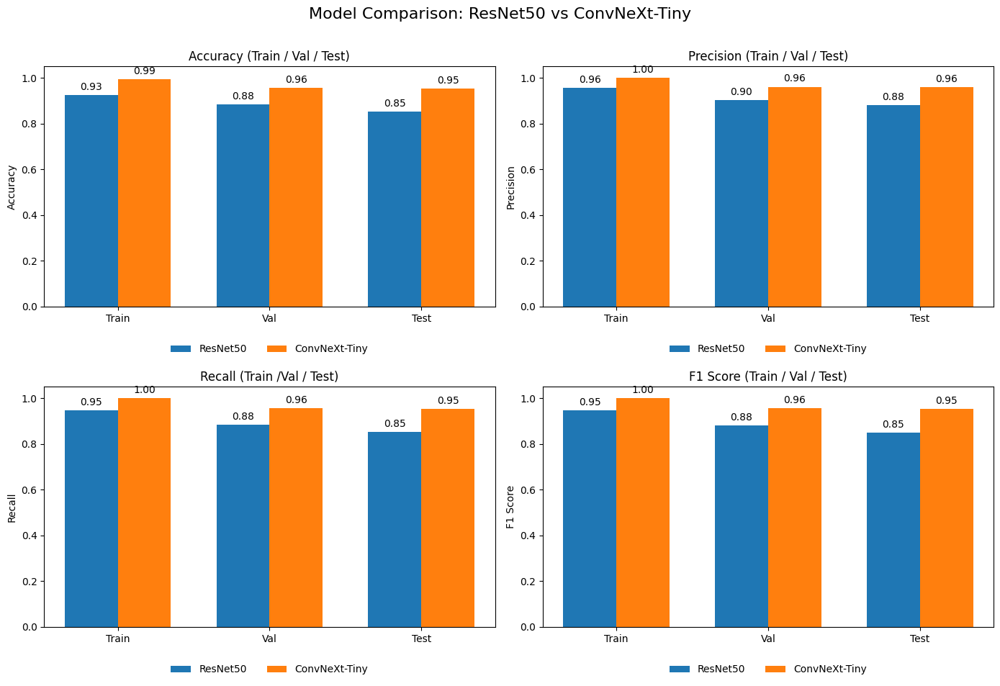

In [53]:
import matplotlib.pyplot as plt


splits_acc = ['Train', 'Val', 'Test']
splits_other = ['Train', 'Val', 'Test']

# Accuracy
resnet_acc = [resnet_summary['Train Accuracy'], resnet_summary['Val Accuracy'], resnet_summary['Test Accuracy']]
conv_acc = [conv_summary['Train Accuracy'], conv_summary['Val Accuracy'], conv_summary['Test Accuracy']]

# Precision
resnet_prec = [resnet_summary['Train Precision'], resnet_summary['Val Precision'], resnet_summary['Test Precision']]
conv_prec = [conv_summary['Train Precision'] ,conv_summary['Val Precision'], conv_summary['Test Precision']]

# Recall
resnet_rec = [resnet_summary['Train Recall'], resnet_summary['Val Recall'], resnet_summary['Test Recall']]
conv_rec = [conv_summary['Train Recall'], conv_summary['Val Recall'], conv_summary['Test Recall']]

# F1
resnet_f1 = [resnet_summary['Train F1'], resnet_summary['Val F1'], resnet_summary['Test F1']]
conv_f1 = [conv_summary['Train F1'], conv_summary['Val F1'], conv_summary['Test F1']]

# Function to plot grouped bar chart
def plot_grouped_bar(ax, labels, resnet_vals, conv_vals, title, ylabel):
    x = np.arange(len(labels))  # label locations
    width = 0.35
    rects1 = ax.bar(x - width/2, resnet_vals, width, label='ResNet50')
    rects2 = ax.bar(x + width/2, conv_vals, width, label='ConvNeXt-Tiny')

    ax.set_ylabel(ylabel)
    ax.set_title(title)
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    ax.set_ylim(0, 1.05)
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.12), ncol=2, frameon=False)
    ax.bar_label(rects1, fmt='%.2f', padding=3)
    ax.bar_label(rects2, fmt='%.2f', padding=3)

# Create subplots
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
axes = axes.flatten()

plot_grouped_bar(axes[0], splits_acc, resnet_acc, conv_acc, "Accuracy (Train / Val / Test)", "Accuracy")
plot_grouped_bar(axes[1], splits_other, resnet_prec, conv_prec, "Precision (Train / Val / Test)", "Precision")
plot_grouped_bar(axes[2], splits_other, resnet_rec, conv_rec, "Recall (Train /Val / Test)", "Recall")
plot_grouped_bar(axes[3], splits_other, resnet_f1, conv_f1, "F1 Score (Train / Val / Test)", "F1 Score")

plt.suptitle("Model Comparison: ResNet50 vs ConvNeXt-Tiny", fontsize=16)
plt.tight_layout(rect=[0, 0.03, 1, 0.97])
plt.show()


# Explain Models

In [54]:
!pip install -q torchcam

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 84.0 MB/s eta 0:00:00:00:010:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 79.6 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 43.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.2 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 3.0 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 4.6 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.5 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.3 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 89.7 MB/s eta 0:00:00:00:0100:01


In [55]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models
from torchvision.transforms import ToPILImage
import matplotlib.pyplot as plt
import numpy as np

In [56]:
from torchvision import transforms
from torchcam.methods import GradCAM
from torchcam.utils import overlay_mask
from PIL import Image
from torchvision.utils import make_grid

In [57]:
resnet_trainer.class_to_idx

{'antelope': 0,
 'badger': 1,
 'bat': 2,
 'bear': 3,
 'bee': 4,
 'beetle': 5,
 'bison': 6,
 'boar': 7,
 'butterfly': 8,
 'cat': 9,
 'caterpillar': 10,
 'chimpanzee': 11,
 'cockroach': 12,
 'cow': 13,
 'coyote': 14,
 'crab': 15,
 'crow': 16,
 'deer': 17,
 'dog': 18,
 'dolphin': 19,
 'donkey': 20,
 'dragonfly': 21,
 'duck': 22,
 'eagle': 23,
 'elephant': 24,
 'flamingo': 25,
 'fly': 26,
 'fox': 27,
 'goat': 28,
 'goldfish': 29,
 'goose': 30,
 'gorilla': 31,
 'grasshopper': 32,
 'hamster': 33,
 'hare': 34,
 'hedgehog': 35,
 'hippopotamus': 36,
 'hornbill': 37,
 'horse': 38,
 'hummingbird': 39,
 'hyena': 40,
 'jellyfish': 41,
 'kangaroo': 42,
 'koala': 43,
 'ladybugs': 44,
 'leopard': 45,
 'lion': 46,
 'lizard': 47,
 'lobster': 48,
 'mosquito': 49,
 'moth': 50,
 'mouse': 51,
 'octopus': 52,
 'okapi': 53,
 'orangutan': 54,
 'otter': 55,
 'owl': 56,
 'ox': 57,
 'oyster': 58,
 'panda': 59,
 'parrot': 60,
 'pelecaniformes': 61,
 'penguin': 62,
 'pig': 63,
 'pigeon': 64,
 'porcupine': 65,
 'pos

In [58]:
idx_to_class = {value: key for key, value in resnet_trainer.class_to_idx.items()}
idx_to_class

{0: 'antelope',
 1: 'badger',
 2: 'bat',
 3: 'bear',
 4: 'bee',
 5: 'beetle',
 6: 'bison',
 7: 'boar',
 8: 'butterfly',
 9: 'cat',
 10: 'caterpillar',
 11: 'chimpanzee',
 12: 'cockroach',
 13: 'cow',
 14: 'coyote',
 15: 'crab',
 16: 'crow',
 17: 'deer',
 18: 'dog',
 19: 'dolphin',
 20: 'donkey',
 21: 'dragonfly',
 22: 'duck',
 23: 'eagle',
 24: 'elephant',
 25: 'flamingo',
 26: 'fly',
 27: 'fox',
 28: 'goat',
 29: 'goldfish',
 30: 'goose',
 31: 'gorilla',
 32: 'grasshopper',
 33: 'hamster',
 34: 'hare',
 35: 'hedgehog',
 36: 'hippopotamus',
 37: 'hornbill',
 38: 'horse',
 39: 'hummingbird',
 40: 'hyena',
 41: 'jellyfish',
 42: 'kangaroo',
 43: 'koala',
 44: 'ladybugs',
 45: 'leopard',
 46: 'lion',
 47: 'lizard',
 48: 'lobster',
 49: 'mosquito',
 50: 'moth',
 51: 'mouse',
 52: 'octopus',
 53: 'okapi',
 54: 'orangutan',
 55: 'otter',
 56: 'owl',
 57: 'ox',
 58: 'oyster',
 59: 'panda',
 60: 'parrot',
 61: 'pelecaniformes',
 62: 'penguin',
 63: 'pig',
 64: 'pigeon',
 65: 'porcupine',
 66: 

In [59]:
num_classes = len(resnet_trainer.class_to_idx)
print('Number of classes: ', num_classes)
class_names = idx_to_class
print('Class Names: ')
class_names

Number of classes:  90
Class Names: 


{0: 'antelope',
 1: 'badger',
 2: 'bat',
 3: 'bear',
 4: 'bee',
 5: 'beetle',
 6: 'bison',
 7: 'boar',
 8: 'butterfly',
 9: 'cat',
 10: 'caterpillar',
 11: 'chimpanzee',
 12: 'cockroach',
 13: 'cow',
 14: 'coyote',
 15: 'crab',
 16: 'crow',
 17: 'deer',
 18: 'dog',
 19: 'dolphin',
 20: 'donkey',
 21: 'dragonfly',
 22: 'duck',
 23: 'eagle',
 24: 'elephant',
 25: 'flamingo',
 26: 'fly',
 27: 'fox',
 28: 'goat',
 29: 'goldfish',
 30: 'goose',
 31: 'gorilla',
 32: 'grasshopper',
 33: 'hamster',
 34: 'hare',
 35: 'hedgehog',
 36: 'hippopotamus',
 37: 'hornbill',
 38: 'horse',
 39: 'hummingbird',
 40: 'hyena',
 41: 'jellyfish',
 42: 'kangaroo',
 43: 'koala',
 44: 'ladybugs',
 45: 'leopard',
 46: 'lion',
 47: 'lizard',
 48: 'lobster',
 49: 'mosquito',
 50: 'moth',
 51: 'mouse',
 52: 'octopus',
 53: 'okapi',
 54: 'orangutan',
 55: 'otter',
 56: 'owl',
 57: 'ox',
 58: 'oyster',
 59: 'panda',
 60: 'parrot',
 61: 'pelecaniformes',
 62: 'penguin',
 63: 'pig',
 64: 'pigeon',
 65: 'porcupine',
 66: 

In [60]:
class ModelExplainer:
    def __init__(self, model_name, model_path, num_classes, class_names, device='cuda'):
        self.num_classes = num_classes
        self.model_path = model_path
        self.model_name = model_name
        self.class_names = class_names
        self.device = torch.device(device if torch.cuda.is_available() else "cpu")
        self.model, self.target_layer = self.load_model_for_explanation()
        self.model = self.model.eval().to(self.device)

    def load_model_for_explanation(self):
        # Instantiate model architecture
        model = getattr(models, self.model_name)(weights="IMAGENET1K_V1")

        # Modify classifier head
        if hasattr(model, "fc"):  # ResNet
            model.fc = nn.Linear(model.fc.in_features, self.num_classes)
            target_layer = model.layer4
            target_layer_name = 'layer4'
        elif hasattr(model, "classifier"):  # ConvNeXt
            model.classifier[2] = nn.Linear(model.classifier[2].in_features, self.num_classes)
            target_layer = model.features[4]
            target_layer_name = 'features.4'
        else:
            raise ValueError("Unsupported model architecture")

        # Load weights
        state_dict = torch.load(self.model_path, map_location=self.device)
        model.load_state_dict(state_dict)

        self.target_layer_name = target_layer_name
        return model, target_layer

    def grad_cam_visualization(self, image_tensor, label, plot=False):
        inv_normalize = transforms.Normalize(
            mean=[-m/s for m, s in zip([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])],
            std=[1/s for s in [0.229, 0.224, 0.225]]
        )

        cam_extractor = GradCAM(self.model, target_layer=self.target_layer_name)
        input_tensor = image_tensor.unsqueeze(0).to(self.device)

        output = self.model(input_tensor)
        class_id = output.argmax().item()

        activation_map = cam_extractor(class_id, output)[0].cpu()

        image = inv_normalize(image_tensor).permute(1, 2, 0).numpy()
        image = np.clip(image, 0, 1)

        result = overlay_mask(Image.fromarray((image * 255).astype('uint8')),
                              Image.fromarray((activation_map.squeeze().numpy() * 255).astype('uint8')),
                              alpha=0.5)

        if plot:
            plt.figure(figsize=(10, 5))
            plt.subplot(1, 2, 1)
            plt.title('Original Image')
            plt.imshow(image)
            plt.axis('off')
            plt.subplot(1, 2, 2)
            plt.imshow(result)
            plt.title(f"Predicted: {self.class_names[class_id]} | True: {self.class_names[label]}")
            plt.axis('off')
            plt.show()
        else:
            return result
        

    def plot_saliency_map(self, input_image, true_label, plot=False, title=None):
        self.model.eval()
        input_image = input_image.unsqueeze(0).to(self.device)
        input_image.requires_grad_()

        output = self.model(input_image)
        self.model.zero_grad()
        target = output[0][true_label]
        target.backward()

        saliency, _ = torch.max(input_image.grad.data.abs(), dim=1)
        saliency = saliency - saliency.min()
        saliency = saliency / saliency.max()

        input_image_np = input_image.squeeze().cpu().detach().numpy().transpose((1, 2, 0))

        # true_label_name = self.class_names[true_label]

        # if title is None:
        #     pred_label = self.class_names[output.argmax().item()]
        #     title = f"Predicted: {pred_label} | True: {true_label}"
            

        if plot:
            fig, ax = plt.subplots(1, 2, figsize=(10, 5))
            ax[0].imshow(input_image_np)
            ax[0].set_title("Original Image")
            ax[0].axis('off')

            pred_label = self.class_names[output.argmax().item()]
            true_label_name = self.class_names[true_label]
            title = f"Predicted: {pred_label} | True: {true_label_name}"
            ax[1].imshow(saliency.squeeze().cpu(), cmap='hot', alpha=0.7)
            ax[1].set_title(title)
            ax[1].axis('off')
        else:
            return saliency, input_image_np


    def grad_and_saliency(self, input_image, label, conf_score=None, title=None):
        grad_res  = self.grad_cam_visualization(input_image, label, plot=False)
        saliency, input_image_np = self.plot_saliency_map(input_image, label, plot=False)

        if title is None:
            title = f"{label}: {conf_score:.2f}%"
        
        fig, ax = plt.subplots(1, 3, figsize=(10, 5))
        ax[0].imshow(input_image_np)
        ax[0].set_title(title)
        ax[0].axis('off')

        ax[1].imshow(saliency.squeeze().cpu(), cmap='hot', alpha=0.7)
        ax[1].set_title("Saliency Map")
        ax[1].axis('off')

        ax[2].imshow(grad_res)
        ax[2].set_title("Grad CAM")
        ax[2].axis('off')

        plt.tight_layout()
        plt.show()

## Explain Resnet50 Model

In [61]:
resnet_model_path = "/kaggle/working/models/resnet50_model.pth"
resnet_exp = ModelExplainer("resnet50", resnet_model_path, num_classes, class_names)

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 208MB/s]


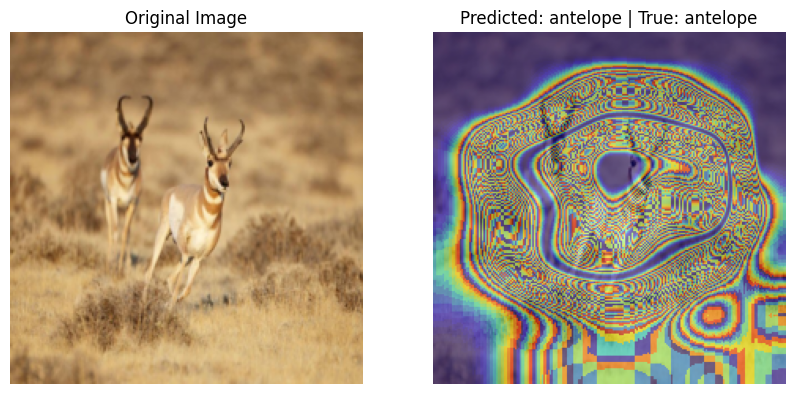

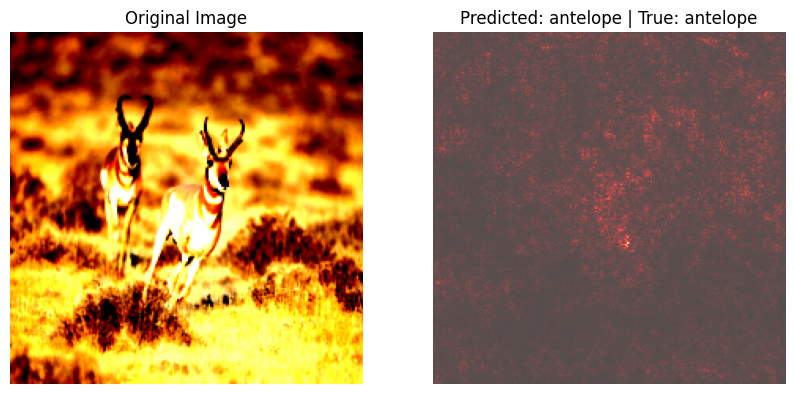

In [62]:
image = Image.open('/kaggle/working/data/land_animals_split/test/antelope/0b688923b0.jpg')
image_tensor = resnet_trainer.val_test_transform(image)
true_class = resnet_trainer.class_to_idx['antelope']
resnet_exp.grad_cam_visualization(image_tensor, label=true_class, plot=True)
resnet_exp.plot_saliency_map(image_tensor, true_label=true_class, plot=True)
# resnet_exp.grad_and_saliency(image_tensor, true_class, conf_score=0.9876)

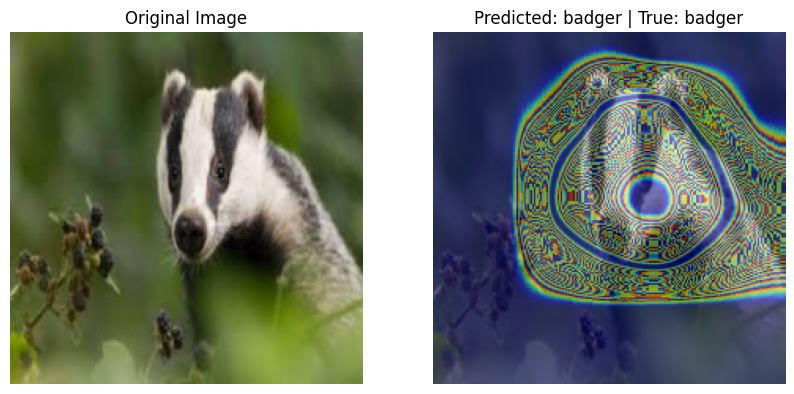

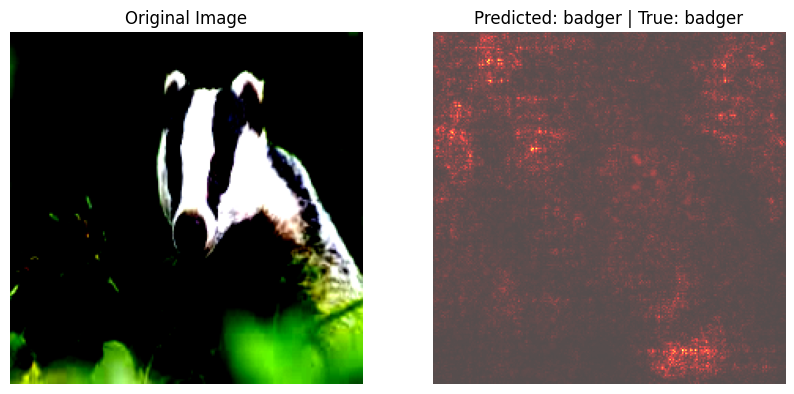

In [63]:
image = Image.open('/kaggle/working/data/land_animals_split/test/badger/10a6d3492c.jpg')
image_tensor = resnet_trainer.val_test_transform(image)
true_class = resnet_trainer.class_to_idx['badger']
resnet_exp.grad_cam_visualization(image_tensor, label=true_class, plot=True)
resnet_exp.plot_saliency_map(image_tensor, true_label=true_class, plot=True)

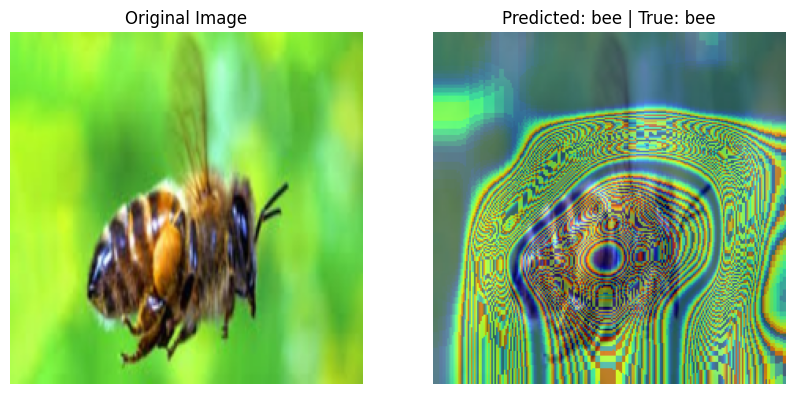

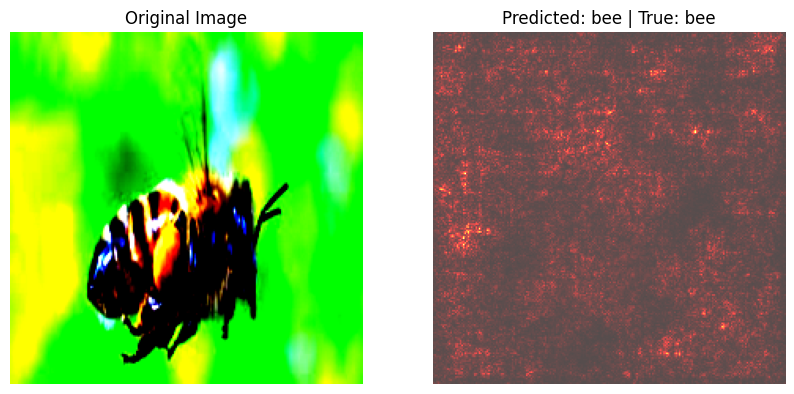

In [64]:
image = Image.open('/kaggle/working/data/land_animals_split/test/bee/462c97a5db.jpg')
image_tensor = resnet_trainer.val_test_transform(image)
true_class = resnet_trainer.class_to_idx['bee']
resnet_exp.grad_cam_visualization(image_tensor, label=true_class, plot=True)
resnet_exp.plot_saliency_map(image_tensor, true_label=true_class, plot=True)

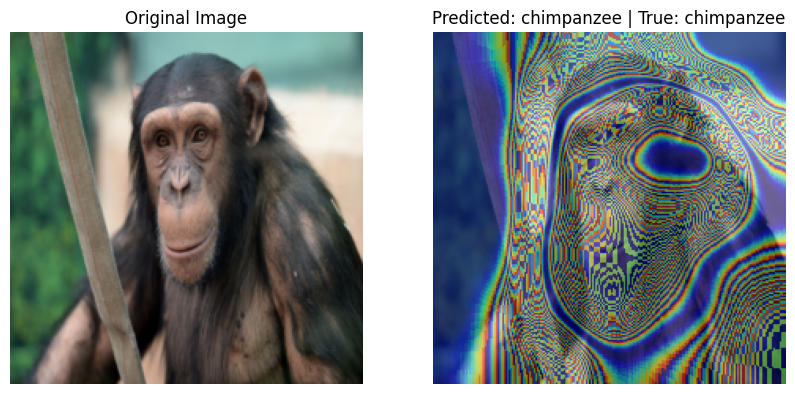

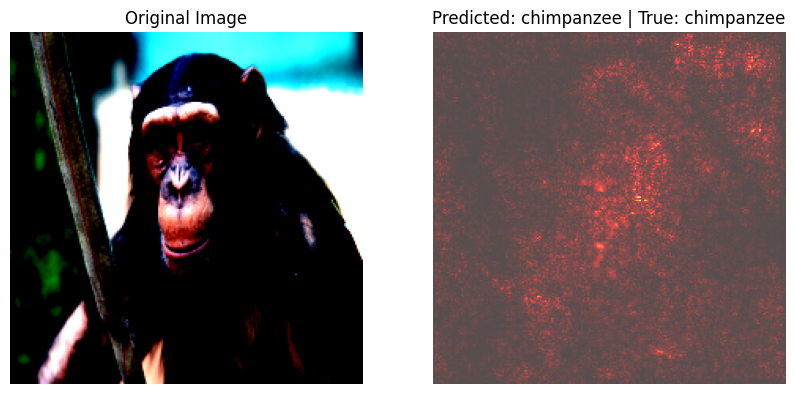

In [65]:
image = Image.open('/kaggle/working/data/land_animals_split/test/chimpanzee/05ffb1984e.jpg')
image_tensor = resnet_trainer.val_test_transform(image)
true_class = resnet_trainer.class_to_idx['chimpanzee']
resnet_exp.grad_cam_visualization(image_tensor, label=true_class, plot=True)
resnet_exp.plot_saliency_map(image_tensor, true_label=true_class, plot=True)

## Explain ConvNext Tiny Model

In [66]:
convt_model_path = "/kaggle/working/models/WildConvnext.pth"
convt_exp = ModelExplainer("convnext_tiny", convt_model_path, num_classes, class_names)

Downloading: "https://download.pytorch.org/models/convnext_tiny-983f1562.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny-983f1562.pth
100%|██████████| 109M/109M [00:00<00:00, 221MB/s] 


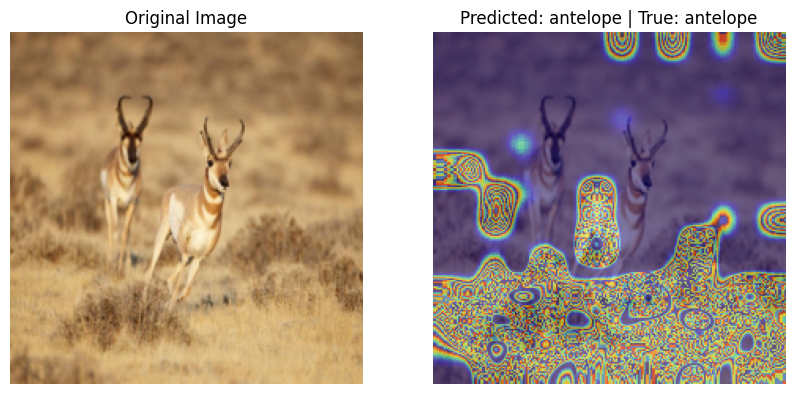

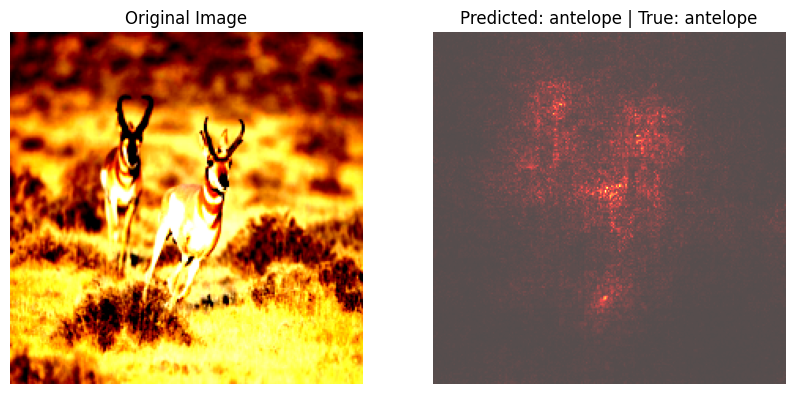

In [67]:
image = Image.open('/kaggle/working/data/land_animals_split/test/antelope/0b688923b0.jpg')
image_tensor = conv_trainer.val_test_transform(image)
true_class = conv_trainer.class_to_idx['antelope']
convt_exp.grad_cam_visualization(image_tensor, label=true_class, plot=True)
convt_exp.plot_saliency_map(image_tensor, true_label=true_class, plot=True)

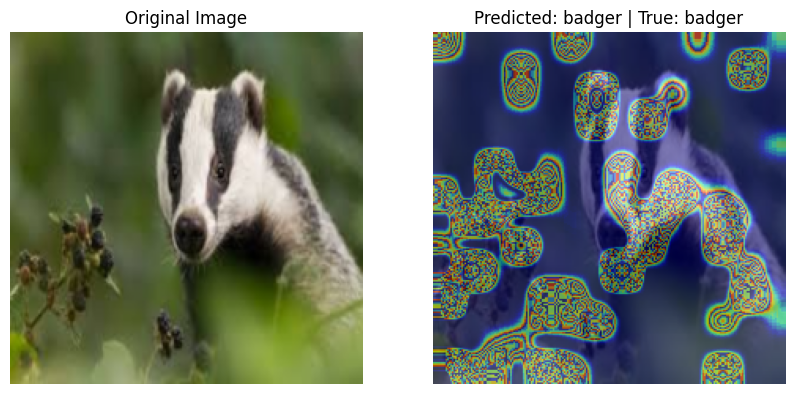

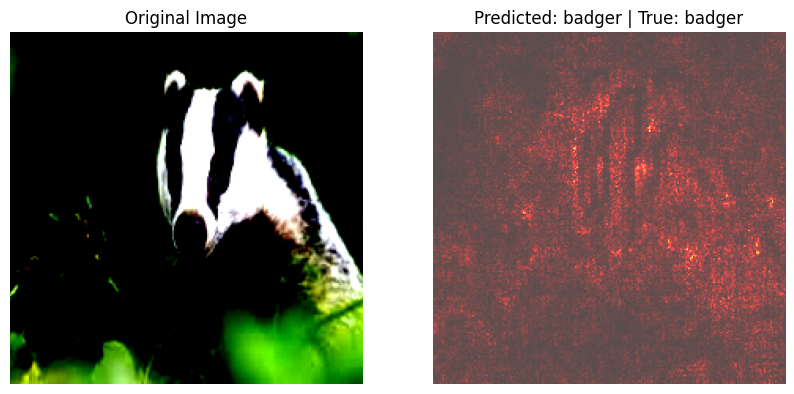

In [68]:
image = Image.open('/kaggle/working/data/land_animals_split/test/badger/10a6d3492c.jpg')
image_tensor = conv_trainer.val_test_transform(image)
true_class = conv_trainer.class_to_idx['badger']
convt_exp.grad_cam_visualization(image_tensor, label=true_class, plot=True)
convt_exp.plot_saliency_map(image_tensor, true_label=true_class, plot=True)

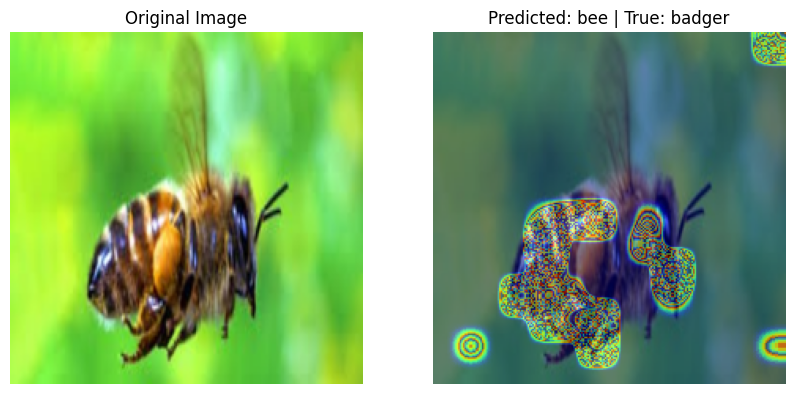

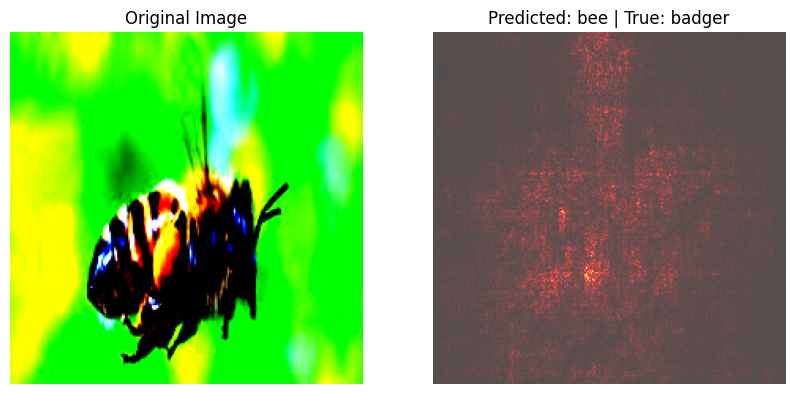

In [69]:
image = Image.open('/kaggle/working/data/land_animals_split/test/bee/462c97a5db.jpg')
image_tensor = conv_trainer.val_test_transform(image)
true_class = conv_trainer.class_to_idx['badger']
convt_exp.grad_cam_visualization(image_tensor, label=true_class, plot=True)
convt_exp.plot_saliency_map(image_tensor, true_label=true_class, plot=True)

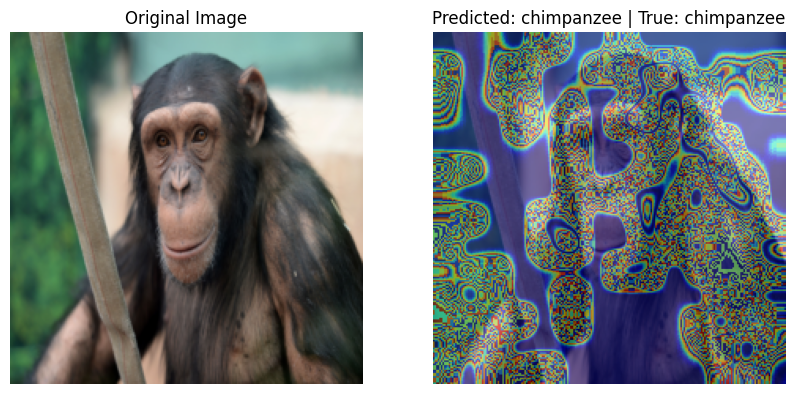

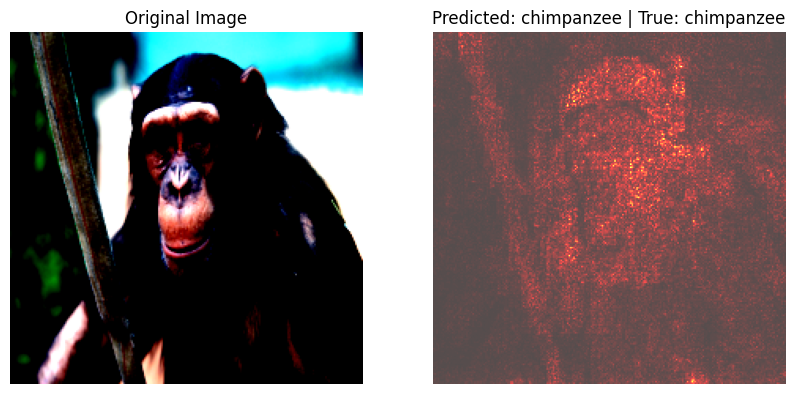

In [70]:
image = Image.open('/kaggle/working/data/land_animals_split/test/chimpanzee/05ffb1984e.jpg')
image_tensor = conv_trainer.val_test_transform(image)
true_class = conv_trainer.class_to_idx['chimpanzee']
convt_exp.grad_cam_visualization(image_tensor, label=true_class, plot=True)
convt_exp.plot_saliency_map(image_tensor, true_label=true_class, plot=True)

# Real Time Predictions using ConvNext Tiny

In [71]:
import os, time, cv2, torch
import numpy as np
import torch.nn as nn
from torchvision.models import convnext_tiny
from torchvision import datasets

DATA_ROOT = "/kaggle/working/data/land_animals_split"   
WEIGHTS   = "/kaggle/working/models/WildConvnext.pth"   
DEVICE    = "cuda" if torch.cuda.is_available() else "cpu"
IMG_SIZE  = 224
USE_FP16  = True     # P100: gives memory savings + small speedup
SHOW_EVERY = 10      # display every Nth frame in notebooks (avoid UI slowdown)

# Load class order exactly like training
train_ds = datasets.ImageFolder(os.path.join(DATA_ROOT, "train"))
classes = train_ds.classes
num_classes = len(classes)
idx_to_class = {i: c for i, c in enumerate(classes)}

# Build model with correct head and load state_dict
model = convnext_tiny(weights=None)
model.classifier[2] = nn.Linear(model.classifier[2].in_features, num_classes)
state = torch.load(WEIGHTS, map_location=DEVICE)
model.load_state_dict(state, strict=True)
model.eval().to(DEVICE)

# Runtime optimizations
if USE_FP16 and DEVICE == "cuda":
    model.half()
model = model.to(memory_format=torch.channels_last)
torch.backends.cudnn.benchmark = True

# Preprocess & predict 
MEAN = np.array([0.485, 0.456, 0.406], dtype=np.float32)
STD  = np.array([0.229, 0.224, 0.225], dtype=np.float32)

def preprocess_bgr(frame_bgr, size=IMG_SIZE):
    rgb = cv2.cvtColor(frame_bgr, cv2.COLOR_BGR2RGB)
    rgb = cv2.resize(rgb, (size, size), interpolation=cv2.INTER_LINEAR)
    x = rgb.astype(np.float32) / 255.0
    x = (x - MEAN) / STD
    x = torch.from_numpy(x).permute(2, 0, 1).unsqueeze(0)  # 1x3xHxW
    if USE_FP16 and DEVICE == "cuda":
        x = x.half()
    return x.to(DEVICE).to(memory_format=torch.channels_last)

@torch.inference_mode()
def predict_frame(frame_bgr, topk=1):
    t = preprocess_bgr(frame_bgr)
    logits = model(t)
    probs = torch.softmax(logits, dim=1)
    top_prob, top_idx = torch.topk(probs, k=topk, dim=1)
    return [(idx_to_class[i.item()], float(p.item())) for i, p in zip(top_idx[0], top_prob[0])]

def predict_image(path, topk=5):
    img = cv2.imread(path)  # BGR
    if img is None:
        raise FileNotFoundError(path)
    return predict_frame(img, topk=topk)

def predict_folder(folder, max_images=200):
    paths = []
    for root, _, files in os.walk(folder):
        for f in files:
            if f.lower().endswith((".jpg",".jpeg",".png",".bmp",".webp")):
                paths.append(os.path.join(root, f))
    paths = paths[:max_images]
    t0 = time.time()
    with torch.inference_mode():
        for p in paths:
            img = cv2.imread(p)
            if img is None: continue
            _ = predict_frame(img)
        if DEVICE == "cuda":
            torch.cuda.synchronize()
    t1 = time.time()
    fps = len(paths) / (t1 - t0) if (t1 - t0) > 0 else 0.0
    print(f"Processed {len(paths)} images in {t1 - t0:.2f}s  ({fps:.1f} FPS)")

def run_realtime(source, display=False, warmup=30, limit=None, annotate=True):
    """
    source: path to video (Kaggle). Use 0 for webcam when running locally.
    display: show frames in notebook .
    warmup: warmup frames to let cuDNN autotune.
    limit: stop after N frames (None = full video).
    annotate: draw label & confidence.
    """
    cap = cv2.VideoCapture(source)
    if not cap.isOpened():
        raise RuntimeError(f"Could not open source: {source}")

    # Warmup
    for _ in range(warmup):
        ok, frame = cap.read()
        if not ok: break
        _ = predict_frame(frame)

    frame_count, t0 = 0, time.time()
    while True:
        ok, frame = cap.read()
        if not ok: break

        preds = predict_frame(frame, topk=1)
        label, prob = preds[0]

        if annotate:
            txt = f"{label}: {prob*100:.1f}%"
            cv2.putText(frame, txt, (12, 28), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0,0,0), 4, cv2.LINE_AA)
            cv2.putText(frame, txt, (12, 28), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255,255,255), 2, cv2.LINE_AA)

        frame_count += 1

        if display and frame_count % SHOW_EVERY == 0:
            # Light-weight preview to avoid slowing the loop
            _, jpg = cv2.imencode(".jpg", frame)
            from IPython.display import display, clear_output
            from PIL import Image
            clear_output(wait=True)
            display(Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)))

        if limit and frame_count >= limit:
            break

    if DEVICE == "cuda":
        torch.cuda.synchronize()
    t1 = time.time()
    fps = frame_count / (t1 - t0) if (t1 - t0) > 0 else 0.0
    print(f"Frames: {frame_count} | Time: {t1 - t0:.2f}s | FPS: {fps:.1f}")
    cap.release()

In [72]:
# 1) Quick sanity check on a single image:
print(predict_image("/kaggle/working/data/land_animals_split/val/antelope/0e17715606.jpg", topk=5))

[('antelope', 0.9921875), ('deer', 0.0018033981323242188), ('hare', 0.0005521774291992188), ('ox', 0.0002620220184326172), ('coyote', 0.00025534629821777344)]


In [73]:
# 2) Measure batch FPS over a folder:
predict_folder("/kaggle/working/data/land_animals_split/test", max_images=300)

Processed 300 images in 3.79s  (79.1 FPS)


In [74]:
# 3) Real-time on a video file in your environment (recommended on Kaggle):
run_realtime("/kaggle/input/test-antelope/istockphoto-1417972374-640_adpp_is.mp4", display=False, warmup=30, limit=500)
# run locally with a webcam: 
# run_realtime(0, display=True)

Frames: 210 | Time: 2.09s | FPS: 100.4


# Risk Score Assignment

In [ ]:
high_risk = [
    "bear", "bison", "boar", "chimpanzee", "coyote", "eagle", "fox", "gorilla",
    "hyena", "leopard", "lion", "lobster", "octopus", "orangutan", "otter",
    "owl", "rhinoceros", "shark", "squid", "tiger", "whale", "wolf"
]
medium_risk = [
    "antelope", "badger", "bat", "deer", "elephant", "flamingo", "goat",
    "goose", "hedgehog", "hippopotamus", "horse", "kangaroo", "koala", "okapi",
    "ox", "panda", "pelecaniformes", "penguin", "pig", "porcupine", "possum", "raccoon",
    "reindeer", "seal", "sheep", "turtle", "wombat", "zebra"
]
low_risk = [
    "bee", "beetle", "butterfly", "cat", "caterpillar", "cockroach", "cow", "crab", "crow", "dog",
    "dolphin", "donkey", "dragonfly", "duck", "fly", "goldfish", "grasshopper", "hare", "hamster",
    "hornbill", "hummingbird", "jellyfish", "ladybugs", "lizard", "mosquito", "moth", "mouse", "oyster",
    "parrot", "pigeon", "rat", "sandpiper", "seahorse", "snake", "sparrow", "squirrel",
    "starfish", "swan", "turkey", "woodpecker"
]
risk_map = {}
for animal in high_risk:
    risk_map[animal] = "high"
for animal in medium_risk:
    risk_map[animal] = "medium"
for animal in low_risk:
    risk_map[animal] = "low"

# Set Up LLM

In [76]:
!pip install -q langchain
!pip install -q langchain-core
!pip install -q transformers
!pip install -q langchain-groq
!pip install -q groq

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.5/65.5 kB 4.7 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bigframes 2.8.0 requires google-cloud-bigquery-storage<3.0.0,>=2.30.0, which is not installed.
datasets 3.6.0 requires fsspec[http]<=2025.3.0,>=2023.1.0, but you have fsspec 2025.5.1 which is incompatible.
datasets 3.6.0 requires pyarrow>=15.0.0, but you have pyarrow 14.0.1 which is incompatible.
cesium 0.12.4 requires numpy<3.0,>=2.0, but you have numpy 1.26.4 which is incompatible.
pandas-gbq 0.29.1 requires google-api-core<3.0.0,>=2.10.2, but you have google-api-core 1.34.1 which is incompatible.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you have numpy 1.26.4 which is incompatible.
cudf-polars-cu12 25.2.2 requires polars<1.22,>=1.20, but you have polars 0.20.0 which is incompatible.
gradio 5.31.0 requires pydantic<2.12,>=2.0, but 

In [ ]:
# from groq import ChatGroq
# from dotenv import load_dotenv
from langchain_core.messages import HumanMessage
from langchain_groq import ChatGroq
from langchain_core.prompts import PromptTemplate
from langchain.output_parsers import StructuredOutputParser, ResponseSchema
import os
# load_dotenv()
# GROQ_API_KEY = os.environ.get('GROQ_API_KEY')
GROQ_API_KEY = "removing_my_api_key"
llm = ChatGroq(model="llama-3.1-8b-instant", api_key=GROQ_API_KEY)

def generate_warning(labels_with_risk, timestamp=None):
    """
    handles multiple species detection.
    labels_with_risk: list of tuples [(label, prob, risk_level), ...]
    """
    schema = [ 
        ResponseSchema(name='sighting_alert', description="A public safety warning regarding animal intrusion"), 
        ResponseSchema(name='safety_precautions', description='Safety precautions that should be taken'), 
        ResponseSchema(name='additional_info', description='Additional Information about the animal that has intruded') 
    ] 
    
    parser = StructuredOutputParser.from_response_schemas(schema)
    
    # Determine the highest risk level among detected species
    risk_levels = [risk for _, _, risk in labels_with_risk]
    if "high" in risk_levels:
        overall_risk = "high"
    elif "medium" in risk_levels:
        overall_risk = "medium"
    else:
        overall_risk = "low"
    
    # Format species list for prompt
    species_list = ", ".join([f"{label} ({prob*100:.1f}%)" for label, prob, _ in labels_with_risk])
    
    template = PromptTemplate(
        template=(
            "You are an emergency response assistant for an AI-powered Animal Intrusion Detection System.\n"
            "The system has detected the presence of multiple animal species near a human-inhabited area:\n"
            "{species_list}\n\n"
            "The overall risk level is classified as {risk_level}.\n\n"
    
            "Your task is to generate a concise and factual **public safety alert** for local residents.\n"
            "Follow these guidelines:\n"
            "1. Do not speculate or include unverified information.\n"
            "2. Use calm but serious language appropriate for a community broadcast.\n"
            "3. Focus on human safety and clear actions residents should take.\n"
            "4. If any animal is dangerous, highlight emergency response steps.\n"
            "5. Address all detected species appropriately based on their risk levels.\n\n"
    
            "Your response must include:\n"
            "- sighting_alert: A one-paragraph alert suitable for a public announcement.\n"
            "- safety_precautions: A short list (2–4 points) of safety measures.\n"
            "- additional_info: One or two relevant facts about the detected animals' behavior or habitat.\n\n"
            "{format_instruction}"
        ),
        input_variables=["species_list", "risk_level"],
        partial_variables={"format_instruction": parser.get_format_instructions()}
    )
    prompt = template.invoke({'species_list': species_list, 'risk_level': overall_risk})
    result = llm.invoke(prompt)
    final_res = parser.parse(result.content)
    return final_res

# Text to Speech Conversion

In [78]:
!pip install -q pyttsx3
!pip install -q threading

ERROR: Could not find a version that satisfies the requirement threading (from versions: none)
ERROR: No matching distribution found for threading


In [79]:
import pyttsx3

def speak(text, repeat=3, save_path=None):
    def _speak(text):
      engine = pyttsx3.init()

      if save_path:
          engine.save_to_file(text, save_path)
      else:
          engine.say(text)

      engine.runAndWait()
    
    for _ in range(repeat):
        _speak(text)

# Alert System

In [ ]:
def preprocess_bgr(frame_bgr, size=IMG_SIZE):
    rgb = cv2.cvtColor(frame_bgr, cv2.COLOR_BGR2RGB)
    rgb = cv2.resize(rgb, (size, size), interpolation=cv2.INTER_LINEAR)
    x = rgb.astype(np.float32) / 255.0
    x = (x - MEAN) / STD
    x = torch.from_numpy(x).permute(2, 0, 1).unsqueeze(0)  # 1x3xHxW
    if USE_FP16 and DEVICE == "cuda":
        x = x.half()
    return x.to(DEVICE).to(memory_format=torch.channels_last)

@torch.inference_mode()
def predict_frame(frame_bgr, topk=10, prob_threshold=0.90, min_confidence=0.5):
    """
    returns species whose cumulative probability exceeds threshold.
    Returns None if highest probability is below min_confidence.
    """
    t = preprocess_bgr(frame_bgr)
    logits = model(t)
    probs = torch.softmax(logits, dim=1)
    top_prob, top_idx = torch.topk(probs, k=topk, dim=1)
    
    # Check if highest probability meets minimum confidence
    highest_prob = float(top_prob[0][0].item())
    if highest_prob < min_confidence:
        return None  # Skip this frame
    
    # Collect predictions until cumulative probability exceeds threshold
    selected_predictions = []
    cumulative_prob = 0.0
    
    for i, p in zip(top_idx[0], top_prob[0]):
        label = idx_to_class[i.item()]
        prob = float(p.item())
        selected_predictions.append((label, prob))
        cumulative_prob += prob
        
        if cumulative_prob >= prob_threshold:
            break
    
    return selected_predictions


from PIL import Image
def annotate_video(input_path, output_path="/kaggle/working/results/annotated.mp4",
                   convt_exp=None, conv_trainer=None):
    cap = cv2.VideoCapture(input_path)
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, cap.get(cv2.CAP_PROP_FPS),
                          (int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)),
                           int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))))
    frame_list = []
    conf_score = []
    alerted_species = set()  # Track species for which alerts have been generated
    
    while True:
        ret, frame = cap.read()
        if not ret:
            break
        
        # Get predictions for current frame
        predictions = predict_frame(frame, topk=10, prob_threshold=0.90, min_confidence=0.5)
        
        # Skip frame if predictions is None (highest confidence < 0.5)
        if predictions is None:
            # Optionally write frame without annotations
            out.write(frame)
            continue
        
        # Extract current labels
        current_labels = set([label for label, _ in predictions])
        
        # Find NEW species that haven't been alerted yet
        new_species = current_labels - alerted_species
        
        # Only process if there are new species detected
        if new_species:
            # Filter for medium and high risk animals with confidence > 0.5
            # Only consider NEW species
            alert_species = []
            for label, prob in predictions:
                if label in new_species:  # Only new species
                    risk_level = risk_map[label]
                    if risk_level in ("medium", "high") and prob > 0.6:
                        alert_species.append((label, prob, risk_level))
                        alerted_species.add(label)  # Mark as alerted
            
            # Generate warning if any NEW medium/high risk species detected
            if alert_species:
                warning = generate_warning(alert_species)
                res = ''
                res += warning['sighting_alert']
                safety = ''.join([s for s in warning['safety_precautions']])
                res += f'\n{safety}'
                res += f"\n{warning['additional_info']}"
                print(f'\n{res}')
                
                # Store frame and detection info
                frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
                frame_list.append(frame_rgb)
                conf_score.append(alert_species)  # Store list of detections
        
        # Overlay all detected species on the frame
        y_offset = 40
        for label, prob in predictions:
            txt = f"{label}: {prob*100:.1f}%"
            cv2.putText(frame, txt, (20, y_offset), cv2.FONT_HERSHEY_SIMPLEX,
                        0.8, (0, 0, 0), 4, cv2.LINE_AA)
            cv2.putText(frame, txt, (20, y_offset), cv2.FONT_HERSHEY_SIMPLEX,
                        0.8, (0, 255, 0), 2, cv2.LINE_AA)
            y_offset += 35
        
        out.write(frame)
    
    cap.release()
    out.release()
    print(f"Saved annotated video to {output_path}")
    return (frame_list, conf_score)


def inspect(frames, conf_score):
    for i, frame_rgb in enumerate(frames):
        frame_pil = Image.fromarray(frame_rgb)
        frame_tensor = conv_trainer.val_test_transform(frame_pil)
        
        # Get all species detected in this frame
        species_list = conf_score[i]  # List of (label, prob, risk_level)
        
        # Visualize for the highest confidence species
        if species_list:
            label, prob, risk_level = species_list[0]  # Highest confidence
            true_class = conv_trainer.class_to_idx[label]
            
            # Create title showing all detected species
            all_species = ", ".join([f"{lbl} ({p*100:.1f}%)" for lbl, p, _ in species_list])
            title = f"Frame {i+1}: {all_species}"
            
            # Call the combined visualization method from ModelExplainer
            convt_exp.grad_and_saliency(frame_tensor, label=true_class,
                                        conf_score=prob, title=title)

In [87]:
frame_list, conf_score = annotate_video(input_path = '/kaggle/input/test-antelope/istockphoto-1417972374-640_adpp_is.mp4', convt_exp=convt_exp, conv_trainer=conv_trainer)


A medium-risk animal intrusion has been detected in the area. Residents are advised to be cautious when outdoors, especially at dawn and dusk when wildlife is most active. Antelope (98.7% confirmed presence) have been spotted in the vicinity. Please remain vigilant and report any further sightings to the authorities immediately.
Keep a safe distance from any wildlife encounteredSecure pets and outdoor food sources to avoid attracting wildlifeBe aware of your surroundings, especially in areas with known wildlife activity
Antelope are generally shy and avoid human interaction. However, they can become aggressive if surprised or provoked. It's essential to respect their personal space and follow the safety precautions outlined above.
Saved annotated video to /kaggle/working/results/annotated.mp4


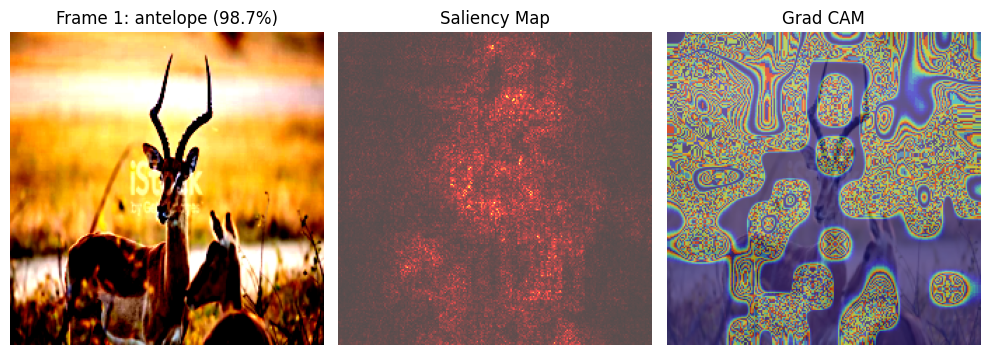

In [86]:
inspect(frame_list, conf_score)

In [88]:
frame_list, conf_score = annotate_video(input_path = '/kaggle/input/mixed-animals-dataset/a-mothers-fury-elephant-strikes-back-after-lion-targets-her-calf-shorts-elephantvslion.mp4', 
                                        convt_exp=convt_exp, conv_trainer=conv_trainer)


A medium-risk animal intrusion has been detected in the vicinity. Residents are advised to remain calm and take necessary precautions. Multiple species have been identified, with elephants being the dominant presence. Please exercise caution and follow safety guidelines provided.
Keep a safe distance from any wild animals, including elephants. Maintain a minimum distance of 10 meters (33 feet) or more.Secure all trash and food waste to avoid attracting animals to residential areas.If you encounter an elephant, stay calm and slowly back away while keeping an eye on the animal. Do not approach or block its path.
Elephants are generally wary of humans but can become aggressive if they feel threatened or if their young or habitat is at risk. They are also attracted to water sources and may be drawn to nearby rivers, lakes, or wetlands in search of hydration.
Saved annotated video to /kaggle/working/results/annotated.mp4


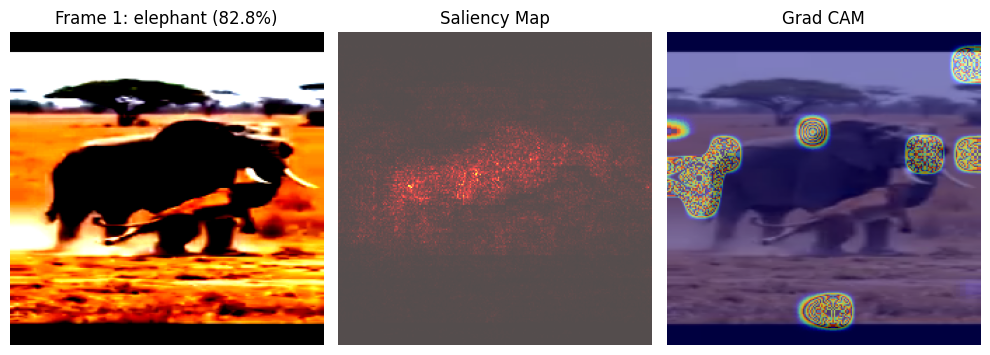

In [89]:
inspect(frame_list, conf_score)

In [90]:
frame_list, conf_score = annotate_video(input_path = '/kaggle/input/tiger-hunt/WhatsApp Video 2025-11-20 at 14.41.14_07125161.mp4', 
                                        output_path = "/kaggle/working/results/lion_elephant.mp4", convt_exp=convt_exp, conv_trainer=conv_trainer)


A high-risk animal intrusion has been detected near human-inhabited areas. A tiger has been identified with an 88.4% probability. Residents are advised to exercise extreme caution and follow the safety precautions outlined below.
Remain indoors and keep all windows and doors closedKeep children and pets indoors and under close supervisionDo not approach or attempt to feed the tiger
Tigers are large carnivores that can be unpredictable and aggressive when feeling threatened or cornered. They typically inhabit dense forests and grasslands, but can adapt to other environments.

A medium-risk animal intrusion has been detected in the area. Please be aware that multiple animals have been spotted, with a high concentration of zebras (78.0%). Residents are advised to exercise caution when outdoors and follow the safety precautions outlined below.
- Stay indoors and keep windows and doors closed.
- Avoid approaching or feeding any wild animals.
- Keep pets on a short leash and under close sup

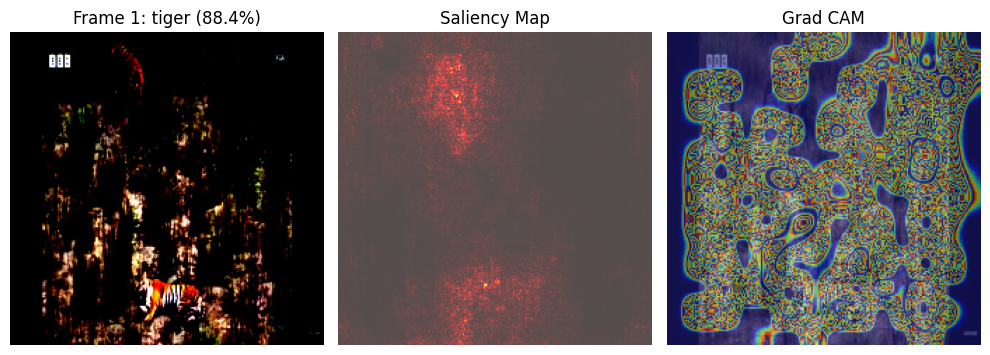

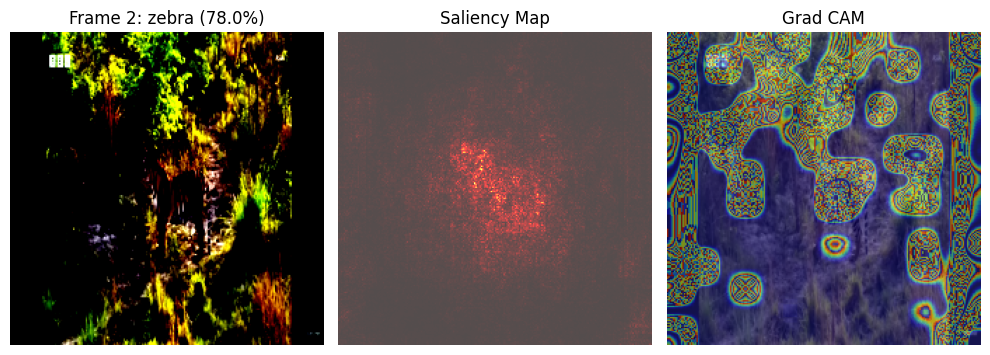

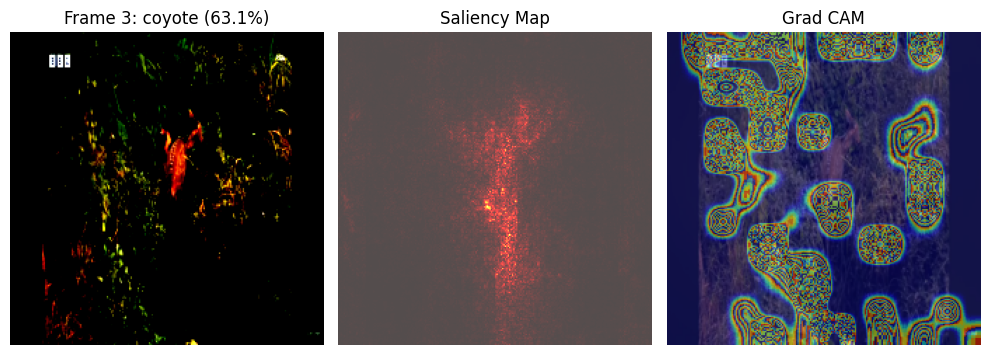

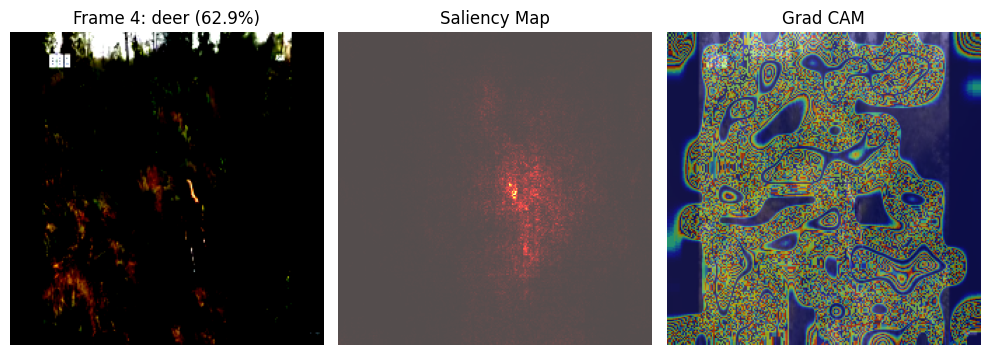

In [91]:
inspect(frame_list, conf_score)

In [119]:
frame_list, conf_score = annotate_video(input_path = '/kaggle/input/elephant-hippo/elephant and hippo.mp4', 
                                        convt_exp=convt_exp, conv_trainer=conv_trainer)


A medium-risk animal intrusion has been detected in the area. While the presence of an elephant is confirmed, we urge residents to exercise caution and follow the safety precautions below.
Stay indoors and keep windows and doors closed.Keep pets on a leash and avoid outdoor activities until further notice.Report any animal sightings to local authorities immediately.
Elephants are generally herbivores and tend to avoid human conflict. However, they can become aggressive when feeling threatened or protecting their young. Habitats with abundant food and water, such as nearby forests or grasslands, may attract elephants.

A medium-risk animal intrusion has been detected in the area. The primary animal species identified is a hippopotamus, posing a potential threat. Please remain calm but exercise caution and follow the safety precautions provided.
Stay indoors and keep windows and doors closedKeep pets indoors and monitor their behaviorAvoid approaching or feeding the animals
Hippopotamus

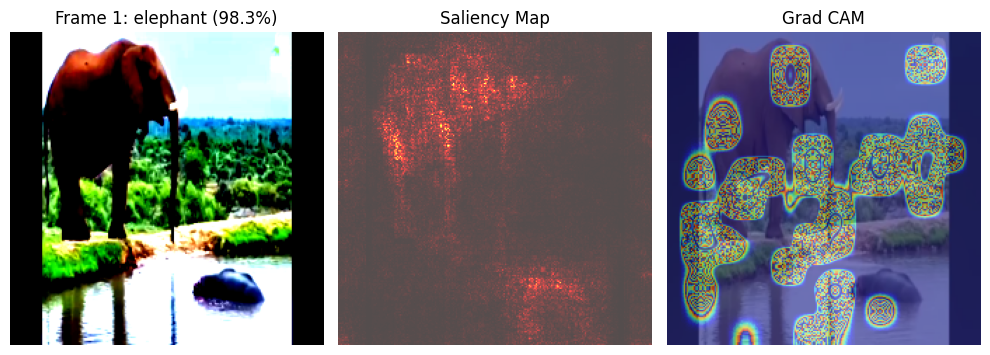

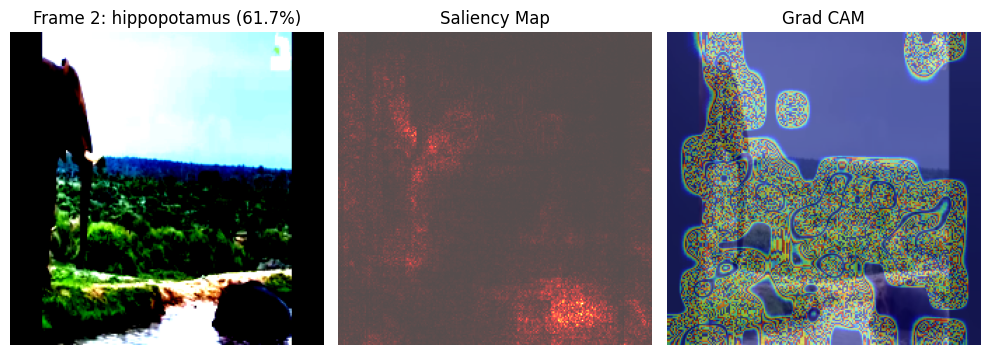

In [121]:
inspect(frame_list, conf_score)

In [122]:
frame_list, conf_score = annotate_video(input_path = '/kaggle/input/lion-hippo/hippo vs lion clan.mp4', 
                                        convt_exp=convt_exp, conv_trainer=conv_trainer)


A medium risk animal intrusion has been detected near the human-inhabited area. Multiple animals have been identified, with a high probability of a hippopotamus presence (94.9%). Residents are advised to exercise caution and follow the safety precautions outlined below.
Stay indoors and keep windows and doors closed until the situation is resolved.Keep children and pets close to ensure their safety.Avoid approaching or attempting to feed any wild animals.
Hippos are semi-aquatic mammals that live in rivers, lakes, and wetlands. They are generally solitary animals and can become aggressive when feeling threatened or during mating season.

A medium-level risk alert has been issued due to the presence of multiple animals near a human-inhabited area. Please be aware of your surroundings and take necessary precautions to ensure your safety. We have detected an elephant in the vicinity, which is a significant threat if provoked.

    - Stay indoors and avoid approaching the detected animal


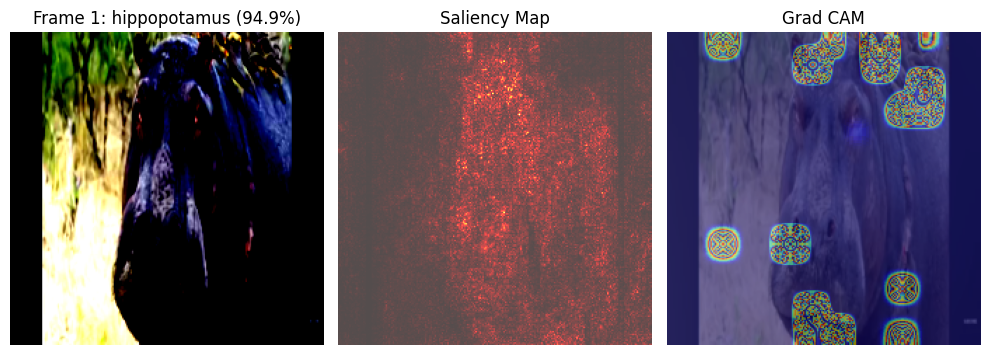

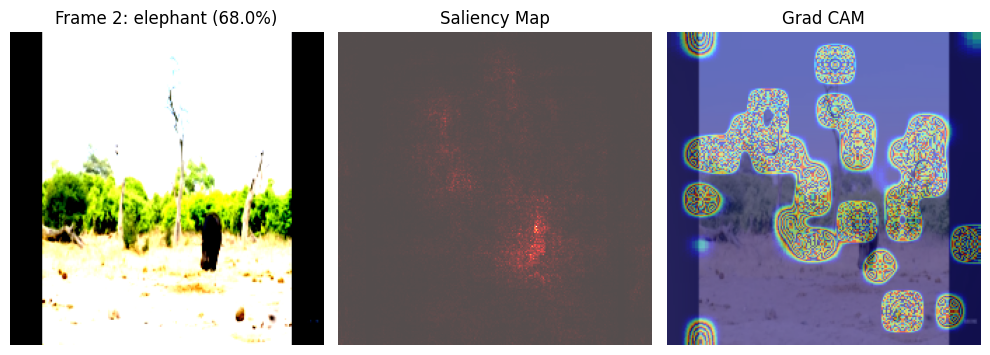

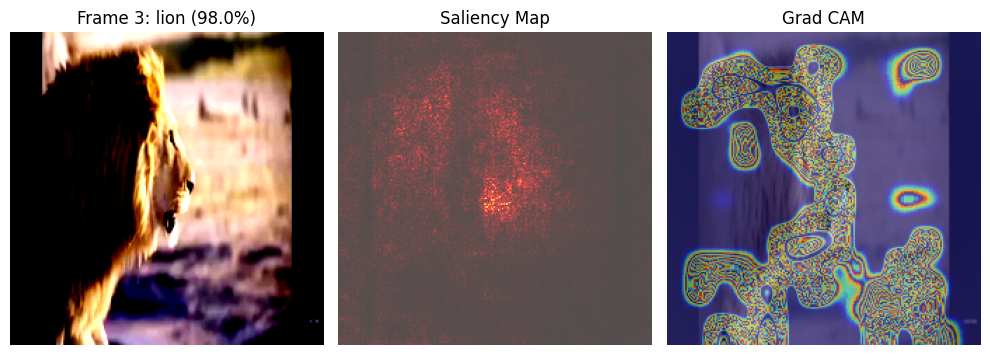

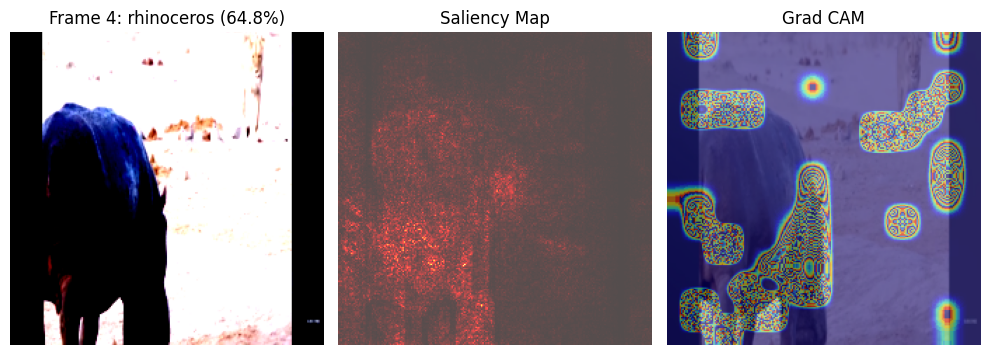

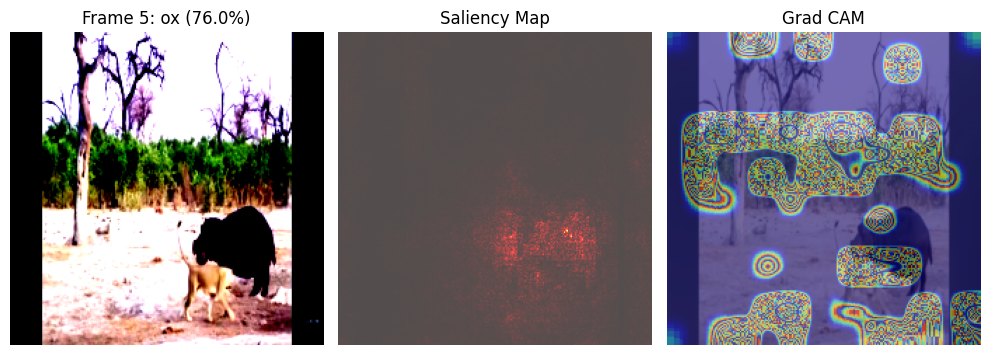

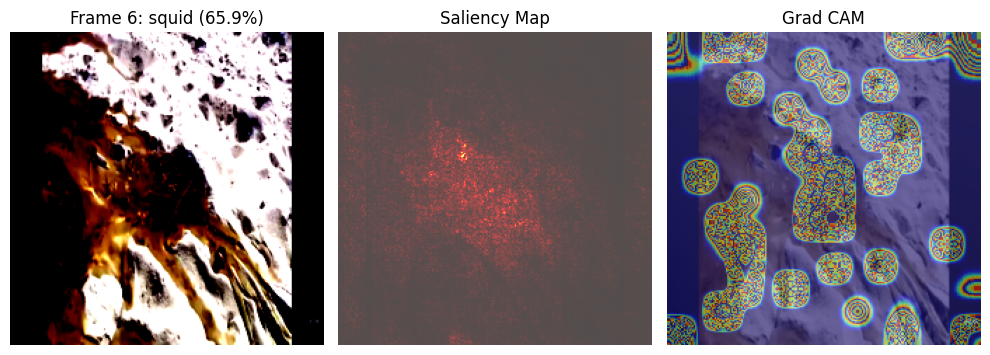

In [123]:
inspect(frame_list, conf_score)

In [106]:
frame_list, conf_score = annotate_video(input_path = '/kaggle/input/lion-and-giraffe/lion-giraffe.mp4', 
                                        convt_exp=convt_exp, conv_trainer=conv_trainer)


A medium-level animal intrusion has been detected near your area. Antelope have been spotted in the vicinity, making up 66.4% of the sighting. Residents are advised to exercise caution and follow safety guidelines.
Keep pets and children close to avoid any potential encounters.Secure all trash cans and outdoor food storage to prevent attracting the animals.Be aware of your surroundings and keep a safe distance from any wildlife you encounter.
Antelope are generally shy and non-aggressive animals, but may become defensive if cornered or threatened. They typically inhabit open grasslands and savannas, and are most active during early morning and late evening hours.

A high-risk animal intrusion has been detected near the human-inhabited area. Residents are advised to exercise extreme caution. A lion has been identified as the primary threat, with a 69.9% sighting probability. Please stay indoors and follow the safety precautions outlined below.
Stay indoors and keep all windows and door